In [25]:
import cantera as ct
import numpy as np
import time
import pandas as pd
import pylab
import matplotlib
import matplotlib.pyplot as plt
import os 
%matplotlib inline

print('Runnning Cantera version: ' + ct.__version__)

Runnning Cantera version: 2.6.0


In [102]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm

x= 1/1000000 

mole_frac_dict = {'H(2)': x, 'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

In [103]:
r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True

states = ct.SolutionArray(gas, extra='t')

dt_max = 1.e-5 
t_end = 1 * dt_max

while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3)


Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [104]:
states.to_pandas().to_csv('./states.csv')
# df = pd.DataFrame(states.X)
# # #df.to_csv('./states.csv')
# df

In [105]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('C2H6(36)')], states.t))
df.to_csv('./C2H6_mole_fractions.csv')
df = pd.DataFrame(zip(states.X[:,gas.species_index('H(2)')], states.t))
df.to_csv('./H_mole_fractions.csv')

Text(0, 0.5, 'mole fraction of H')

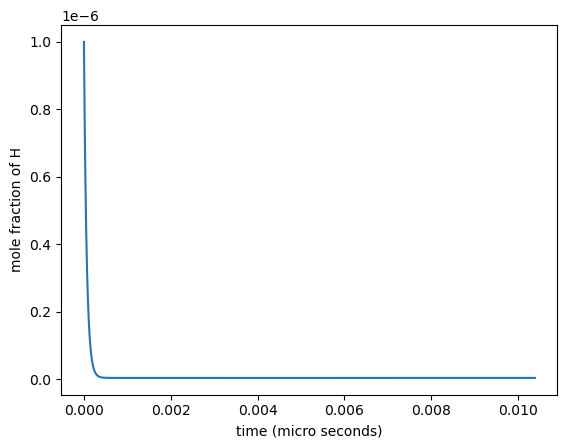

In [106]:
plt.plot(states.t, states.X[:,gas.species_index('H(2)')])
plt.xlabel('time (micro seconds)')
plt.ylabel('mole fraction of H')

Text(0, 0.5, 'mole fraction of H')

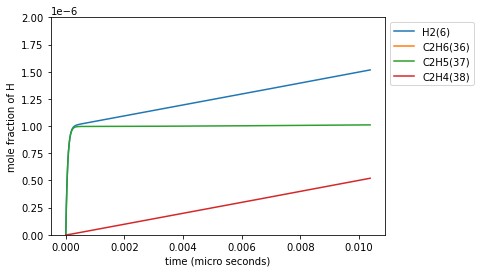

In [209]:
for spc in gas.species():
    if states.X[:,gas.species_index(spc.name)][-1] > 0.25e-7:
        plt.plot(states.t, states.X[:,gas.species_index(spc.name)], label=spc.name)
    # else: 
    #     print(states.X[:,gas.species_index(spc.name)][-1])

plt.legend(bbox_to_anchor=(1,1))
plt.ylim(0,0.2e-5)
plt.xlabel('time (micro seconds)')
plt.ylabel('mole fraction of H')

## Question 1.a

**On what timescale does the mole fraction of H atoms drop (i.e. what is the half-life of an H atom in this system at these conditions)?**

approximately 4.43e-08 seconds 

**Does the mole fraction of ethane change much on this short 
timescale?** 

No, the mole fraction begins at 0.9999990000009809 and only decreases to 0.9999984937017967 (barely any change). 


**What product species are being formed rapidly as the H atoms react, 
formed by what reaction?**

H2 and C2H5 are being formed rapidly by reaction #25: C2H6(36) + H(2) <=> C2H5(37) + H2(6). 


**Plot the logarithm of H atom mole fraction versus time; 
is the plot linear at short times as expected if the H atom decay is exponential in 
time? (If the plot is linear, we call this a pseudo-first-order process; pseudo 
because the H atoms are actually participating in bimolecular reactions not 
decaying unimolecularly.). What happens at slightly longer times?***

Yes, the plot is linear at short times and platues at longer times (see below). 


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, 'log(H atom mole fraction) v. time')

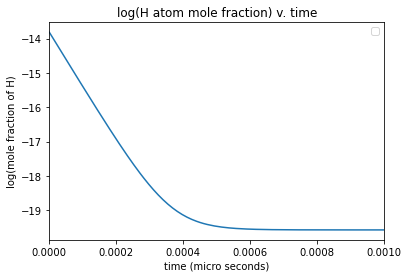

In [202]:
plt.plot(states.t, np.log(states.X[:,gas.species_index('H(2)')]))
    # else: 
    #     print(states.X[:,gas.species_index(spc.name)][-1])

plt.legend(bbox_to_anchor=(1,1))
plt.xlim(0,0.001)
plt.xlabel('time (micro seconds)')
plt.ylabel('log(mole fraction of H)')
plt.title('log(H atom mole fraction) v. time')

In [130]:
#find all the reactions that have H(2) in it

H_rxns = []
C2H6_rxns = []

for index, reaction in enumerate(gas.reactions()):
    if 'H(2)' in reaction.products.keys() or 'H(2)' in reaction.reactants.keys():
        # print(reaction.products.keys())
        #print(index, reaction)
        H_rxns.append(index)
        
for index, reaction in enumerate(gas.reactions()):
    if 'C2H6(36)' in reaction.products.keys() or 'C2H6(36)' in reaction.reactants.keys():
        #print(index, reaction)
        C2H6_rxns.append(index)
        
#now let's get the code that will add it in to the states csv
# for index in H2_rxns: 
     #print( f's{index} = sim.sensitivity("H2(6)", {index})')

# for index in C2H6_rxns: 
    #print( f's{index} = sim.sensitivity("C2H6(36)", {index})')

all_indices = H_rxns
    
    
strings_to_combine = []
for index in all_indices: 
    #strings_to_combine.append(f's{index}=s{index}')
    strings_to_combine.append(f's{index}')


strings_to_combine

['s15',
 's16',
 's17',
 's18',
 's19',
 's20',
 's21',
 's22',
 's23',
 's24',
 's25',
 's26',
 's27',
 's28',
 's29',
 's30',
 's31',
 's32',
 's33',
 's34',
 's43',
 's44',
 's49',
 's50',
 's51',
 's62',
 's69',
 's70',
 's77',
 's83',
 's89',
 's90',
 's102',
 's104',
 's110',
 's111',
 's112',
 's118',
 's135',
 's137',
 's147',
 's155',
 's171',
 's177',
 's186',
 's188',
 's189',
 's208',
 's209',
 's213',
 's214',
 's222',
 's225',
 's239',
 's245',
 's255',
 's264',
 's265',
 's269',
 's271',
 's290',
 's291',
 's292',
 's293',
 's294',
 's295',
 's296',
 's322',
 's323',
 's324',
 's329',
 's344',
 's359',
 's371',
 's372',
 's398',
 's408',
 's420',
 's428',
 's438',
 's454',
 's455',
 's512',
 's513',
 's514',
 's520',
 's524',
 's525',
 's526',
 's527',
 's528',
 's530',
 's545',
 's570',
 's571',
 's574',
 's602',
 's604',
 's609',
 's611',
 's612',
 's613',
 's614',
 's615',
 's616']

# Question 1.b

**Use “Rate of Production” (ROP) analysis during the very early times to confirm that the expected reaction is indeed responsible for most of the loss of H atom.**

The .png with the Reaction Path shows the flux diagram that indicates #25 (C2H6(36) + H(2) <=> C2H5(37) + H2(6)) is largely responsible for the loss of H.

In [262]:
gas = ct.Solution('./propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

 
# Define the element to follow in the reaction path diagram:
element = 'H'
 
# Initiate the reaction path diagram:
diagram = ct.ReactionPathDiagram(gas, element)
 
# Define the filenames:
dot_file = 'ReactionPathDiagram_withH.dot'
img_file = 'ReactionPathDiagram_withH.png'
 
# Write the dot-file first, then create the image from the dot-file with customizable
# parameters:
diagram.write_dot(dot_file)
os.system('dot {0} -Tpng -o{1} -Gdpi=300'.format(dot_file, img_file))


0

**If only this reaction matters, then one should be able to determine the rate 
coefficient k(T) of this key reaction from the half-life of the H atom (for example, 
if you measured the half-life for decay of H atoms experimentally.) Give the 
algebraic expression for k in terms of the half-life and the initial mole fractions 
and pressure.**

work shown in the screenshot below.

**If you plug in the value of the half-life from the plots of H vs. time, 
do you get a value for k(1000 K) that is consistent with the Arrhenius parameters 
for the key reaction given in the chem.inp file?**

No, I did not. Not sure why this happened.
Calculated k: 15643340.85778781, k using parameters from chemkin: 2599449.0439144396

In [208]:
k_using_half_life = 0.693/((4.43e-05)/1000)
k_using_chemkin = (1.150000e+08)*((1000/300)**1.9)*np.exp(-7.53/((1.987e-3)*(1000)))

print(f'Calculated k: {k_using_half_life:}, k using parameters from chemkin: {k_using_chemkin}')


Calculated k: 15643340.85778781, k using parameters from chemkin: 25606541.45946374


# Question 1.c

**Use sensitivity analysis on this short time scale to confirm that the mole fraction 
of H atom at the t*=thalflife you are using is only sensitive to the k for the one key 
reaction, i.e. that your analysis in part (b) is sensible.**

The two bar plot show that the mole fraction of H (I used concentration in this sensitivity analysis) is only sensitive to the k for rxn #25 ( C2H6(36) + H(2) <=> C2H5(37) + H2(6))

Text(0.5, 1.0, 'Sensitivity of H concentration to rate of reactions involving H')

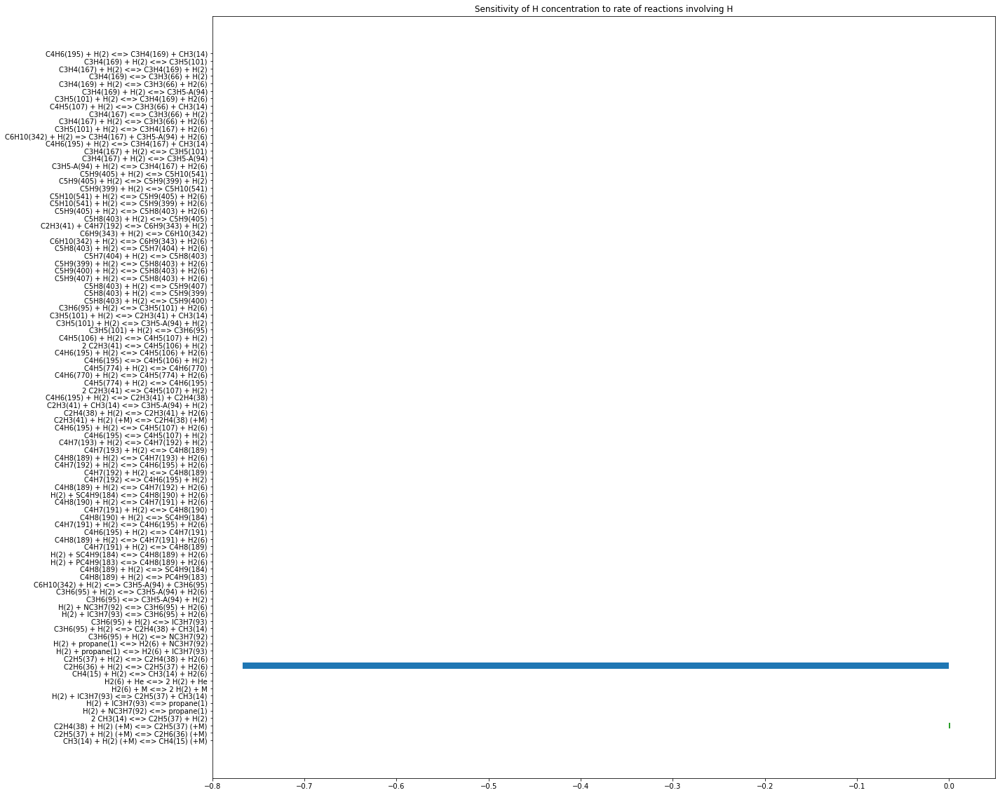

In [148]:
df_sens = pd.read_csv('./edited_sensitivities.csv')
H2_sensitivities = df_sens[['s15',
's16',
's17',
's18',
's19',
's20',
's21',
's22',
's23',
's24',
's25',
's26',
's27',
's28',
's29',
's30',
's31',
's32',
's33',
's34',
's43',
's44',
's49',
's50',
's51',
's62',
's69',
's70',
's77',
's83',
's89',
's90',
's102',
's104',
's110',
's111',
's112',
's118',
's135',
's137',
's147',
's155',
's171',
's177',
's186',
's188',
's189',
's208',
's209',
's213',
's214',
's222',
's225',
's239',
's245',
's255',
's264',
's265',
's269',
's271',
's290',
's291',
's292',
's293',
's294',
's295',
's296',
's322',
's323',
's324',
's329',
's344',
's359',
's371',
's372',
's398',
's408',
's420',
's428',
's438',
's454',
's455',
's512',
's513',
's514',
's520',
's524',
's525',
's526',
's527',
's528',
's530',
's545',
's570',
's571',
's574',
's602',
's604',
's609',
's611',
's612',
's613',
's614',
's615',
's616']]

for index, row in H2_sensitivities.iterrows():
    if index == 43:
        s15=row['s15']
        s16=row['s16']
        s17=row['s17']
        s18=row['s18']
        s19=row['s19']
        s20=row['s20']
        s21=row['s21']
        s22=row['s22']
        s23=row['s23']
        s24=row['s24']
        s25=row['s25']
        s26=row['s26']
        s27=row['s27']
        s28=row['s28']
        s29=row['s29']
        s30=row['s30']
        s31=row['s31']
        s32=row['s32']
        s33=row['s33']
        s34=row['s34']
        s43=row['s43']
        s44=row['s44']
        s49=row['s49']
        s50=row['s50']
        s51=row['s51']
        s62=row['s62']
        s69=row['s69']
        s70=row['s70']
        s77=row['s77']
        s83=row['s83']
        s89=row['s89']
        s90=row['s90']
        s102=row['s102']
        s104=row['s104']
        s110=row['s110']
        s111=row['s111']
        s112=row['s112']
        s118=row['s118']
        s135=row['s135']
        s137=row['s137']
        s147=row['s147']
        s155=row['s155']
        s171=row['s171']
        s177=row['s177']
        s186=row['s186']
        s188=row['s188']
        s189=row['s189']
        s208=row['s208']
        s209=row['s209']
        s213=row['s213']
        s214=row['s214']
        s222=row['s222']
        s225=row['s225']
        s239=row['s239']
        s245=row['s245']
        s255=row['s255']
        s264=row['s264']
        s265=row['s265']
        s269=row['s269']
        s271=row['s271']
        s290=row['s290']
        s291=row['s291']
        s292=row['s292']
        s293=row['s293']
        s294=row['s294']
        s295=row['s295']
        s296=row['s296']
        s322=row['s322']
        s323=row['s323']
        s324=row['s324']
        s329=row['s329']
        s344=row['s344']
        s359=row['s359']
        s371=row['s371']
        s372=row['s372']
        s398=row['s398']
        s408=row['s408']
        s420=row['s420']
        s428=row['s428']
        s438=row['s438']
        s454=row['s454']
        s455=row['s455']
        s512=row['s512']
        s513=row['s513']
        s514=row['s514']
        s520=row['s520']
        s524=row['s524']
        s525=row['s525']
        s526=row['s526']
        s527=row['s527']
        s528=row['s528']
        s530=row['s530']
        s545=row['s545']
        s570=row['s570']
        s571=row['s571']
        s574=row['s574']
        s602=row['s602']
        s604=row['s604']
        s609=row['s609']
        s611=row['s611']
        s612=row['s612']
        s613=row['s613']
        s614=row['s614']
        s615=row['s615']
        s616=row['s616']

plt.figure(figsize=(20,20))

plt.barh("CH3(14) + H(2) (+M) <=> CH4(15) (+M)", s15)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)", s17)
plt.barh("2 CH3(14) <=> C2H5(37) + H(2)", s18)
plt.barh("H(2) + NC3H7(92) <=> propane(1)", s19)
plt.barh("H(2) + IC3H7(93) <=> propane(1)", s20)
plt.barh("H(2) + IC3H7(93) <=> C2H5(37) + CH3(14)", s21)
plt.barh("H2(6) + M <=> 2 H(2) + M", s22)
plt.barh("H2(6) + He <=> 2 H(2) + He", s23)
plt.barh("CH4(15) + H(2) <=> CH3(14) + H2(6)", s24)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25)
plt.barh("C2H5(37) + H(2) <=> C2H4(38) + H2(6)", s26)
plt.barh("H(2) + propane(1) <=> H2(6) + IC3H7(93)", s27)
plt.barh("H(2) + propane(1) <=> H2(6) + NC3H7(92)", s28)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s29)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s30)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s31)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s32)
plt.barh("C3H6(95) + H(2) <=> IC3H7(93)", s33)
plt.barh("C3H6(95) + H(2) <=> IC3H7(93)", s34)
plt.barh("H(2) + IC3H7(93) <=> C3H6(95) + H2(6)", s43)
plt.barh("H(2) + NC3H7(92) <=> C3H6(95) + H2(6)", s44)
plt.barh("C3H6(95) <=> C3H5-A(94) + H(2)", s49)
plt.barh("C3H6(95) <=> C3H5-A(94) + H(2)", s50)
plt.barh("C3H6(95) + H(2) <=> C3H5-A(94) + H2(6)", s51)
plt.barh("C6H10(342) + H(2) <=> C3H5-A(94) + C3H6(95)", s62)
plt.barh("C4H8(189) + H(2) <=> PC4H9(183)", s69)
plt.barh("C4H8(189) + H(2) <=> SC4H9(184)", s70)
plt.barh("H(2) + PC4H9(183) <=> C4H8(189) + H2(6)", s77)
plt.barh("H(2) + SC4H9(184) <=> C4H8(189) + H2(6)", s83)
plt.barh("C4H7(191) + H(2) <=> C4H8(189)", s89)
plt.barh("C4H8(189) + H(2) <=> C4H7(191) + H2(6)", s90)
plt.barh("C4H6(195) + H(2) <=> C4H7(191)", s102)
plt.barh("C4H7(191) + H(2) <=> C4H6(195) + H2(6)", s104)
plt.barh("C4H8(190) + H(2) <=> SC4H9(184)", s110)
plt.barh("C4H7(191) + H(2) <=> C4H8(190)", s111)
plt.barh("C4H8(190) + H(2) <=> C4H7(191) + H2(6)", s112)
plt.barh("H(2) + SC4H9(184) <=> C4H8(190) + H2(6)", s118)
plt.barh("C4H8(189) + H(2) <=> C4H7(192) + H2(6)", s135)
plt.barh("C4H7(192) <=> C4H6(195) + H(2)", s137)
plt.barh("C4H7(192) + H(2) <=> C4H8(189)", s147)
plt.barh("C4H7(192) + H(2) <=> C4H6(195) + H2(6)", s155)
plt.barh("C4H8(189) + H(2) <=> C4H7(193) + H2(6)", s171)
plt.barh("C4H7(193) + H(2) <=> C4H8(189)", s177)
plt.barh("C4H7(193) + H(2) <=> C4H7(192) + H(2)", s186)
plt.barh("C4H6(195) <=> C4H5(107) + H(2)", s188)
plt.barh("C4H6(195) + H(2) <=> C4H5(107) + H2(6)", s189)
plt.barh("C2H3(41) + H(2) (+M) <=> C2H4(38) (+M)", s208)
plt.barh("C2H4(38) + H(2) <=> C2H3(41) + H2(6)", s209)
plt.barh("C2H3(41) + CH3(14) <=> C3H5-A(94) + H(2)", s213)
plt.barh("C2H3(41) + CH3(14) <=> C3H5-A(94) + H(2)", s214)
plt.barh("C4H6(195) + H(2) <=> C2H3(41) + C2H4(38)", s222)
plt.barh("2 C2H3(41) <=> C4H5(107) + H(2)", s225)
plt.barh("C4H5(774) + H(2) <=> C4H6(195)", s239)
plt.barh("C4H6(770) + H(2) <=> C4H5(774) + H2(6)", s245)
plt.barh("C4H5(774) + H(2) <=> C4H6(770)", s255)
plt.barh("C4H6(195) <=> C4H5(106) + H(2)", s264)
plt.barh("C4H6(195) + H(2) <=> C4H5(106) + H2(6)", s265)
plt.barh("2 C2H3(41) <=> C4H5(106) + H(2)", s269)
plt.barh("C4H5(106) + H(2) <=> C4H5(107) + H(2)", s271)
plt.barh("C3H5(101) + H(2) <=> C3H6(95)", s290)
plt.barh("C3H5(101) + H(2) <=> C3H6(95)", s291)
plt.barh("C3H5(101) + H(2) <=> C3H5-A(94) + H(2)", s292)
plt.barh("C3H5(101) + H(2) <=> C3H5-A(94) + H(2)", s293)
plt.barh("C3H5(101) + H(2) <=> C2H3(41) + CH3(14)", s294)
plt.barh("C3H5(101) + H(2) <=> C2H3(41) + CH3(14)", s295)
plt.barh("C3H6(95) + H(2) <=> C3H5(101) + H2(6)", s296)
plt.barh("C5H8(403) + H(2) <=> C5H9(400)", s322)
plt.barh("C5H8(403) + H(2) <=> C5H9(399)", s323)
plt.barh("C5H8(403) + H(2) <=> C5H9(407)", s324)
plt.barh("C5H9(407) + H(2) <=> C5H8(403) + H2(6)", s329)
plt.barh("C5H9(400) + H(2) <=> C5H8(403) + H2(6)", s344)
plt.barh("C5H9(399) + H(2) <=> C5H8(403) + H2(6)", s359)
plt.barh("C5H7(404) + H(2) <=> C5H8(403)", s371)
plt.barh("C5H8(403) + H(2) <=> C5H7(404) + H2(6)", s372)
plt.barh("C6H10(342) + H(2) <=> C6H9(343) + H2(6)", s398)
plt.barh("C6H9(343) + H(2) <=> C6H10(342)", s408)
plt.barh("C2H3(41) + C4H7(192) <=> C6H9(343) + H(2)", s420)
plt.barh("C5H8(403) + H(2) <=> C5H9(405)", s428)
plt.barh("C5H9(405) + H(2) <=> C5H8(403) + H2(6)", s438)
plt.barh("C5H10(541) + H(2) <=> C5H9(399) + H2(6)", s454)
plt.barh("C5H10(541) + H(2) <=> C5H9(405) + H2(6)", s455)
plt.barh("C5H9(399) + H(2) <=> C5H10(541)", s512)
plt.barh("C5H9(405) + H(2) <=> C5H9(399) + H(2)", s513)
plt.barh("C5H9(405) + H(2) <=> C5H10(541)", s514)
plt.barh("C3H5-A(94) + H(2) <=> C3H4(167) + H2(6)", s520)
plt.barh("C3H4(167) + H(2) <=> C3H5-A(94)", s524)
plt.barh("C3H4(167) + H(2) <=> C3H5-A(94)", s525)
plt.barh("C3H4(167) + H(2) <=> C3H5(101)", s526)
plt.barh("C3H4(167) + H(2) <=> C3H5(101)", s527)
plt.barh("C4H6(195) + H(2) <=> C3H4(167) + CH3(14)", s528)
plt.barh("C6H10(342) + H(2) => C3H4(167) + C3H5-A(94) + H2(6)", s530)
plt.barh("C3H5(101) + H(2) <=> C3H4(167) + H2(6)", s545)
plt.barh("C3H4(167) + H(2) <=> C3H3(66) + H2(6)", s570)
plt.barh("C3H4(167) <=> C3H3(66) + H(2)", s571)
plt.barh("C4H5(107) + H(2) <=> C3H3(66) + CH3(14)", s574)
plt.barh("C3H5(101) + H(2) <=> C3H4(169) + H2(6)", s602)
plt.barh("C3H4(169) + H(2) <=> C3H5-A(94)", s604)
plt.barh("C3H4(169) + H(2) <=> C3H3(66) + H2(6)", s609)
plt.barh("C3H4(169) <=> C3H3(66) + H(2)", s611)
plt.barh("C3H4(167) + H(2) <=> C3H4(169) + H(2)", s612)
plt.barh("C3H4(167) + H(2) <=> C3H4(169) + H(2)", s613)
plt.barh("C3H4(169) + H(2) <=> C3H5(101)", s614)
plt.barh("C3H4(169) + H(2) <=> C3H5(101)", s615)
plt.barh("C4H6(195) + H(2) <=> C3H4(169) + CH3(14)", s616)


plt.xlim(-0.8,0.05)
plt.title('Sensitivity of H concentration to rate of reactions involving H')

Text(0.5, 1.0, 'Sensitivity of H2 concentration to rate of reactions involving H2')

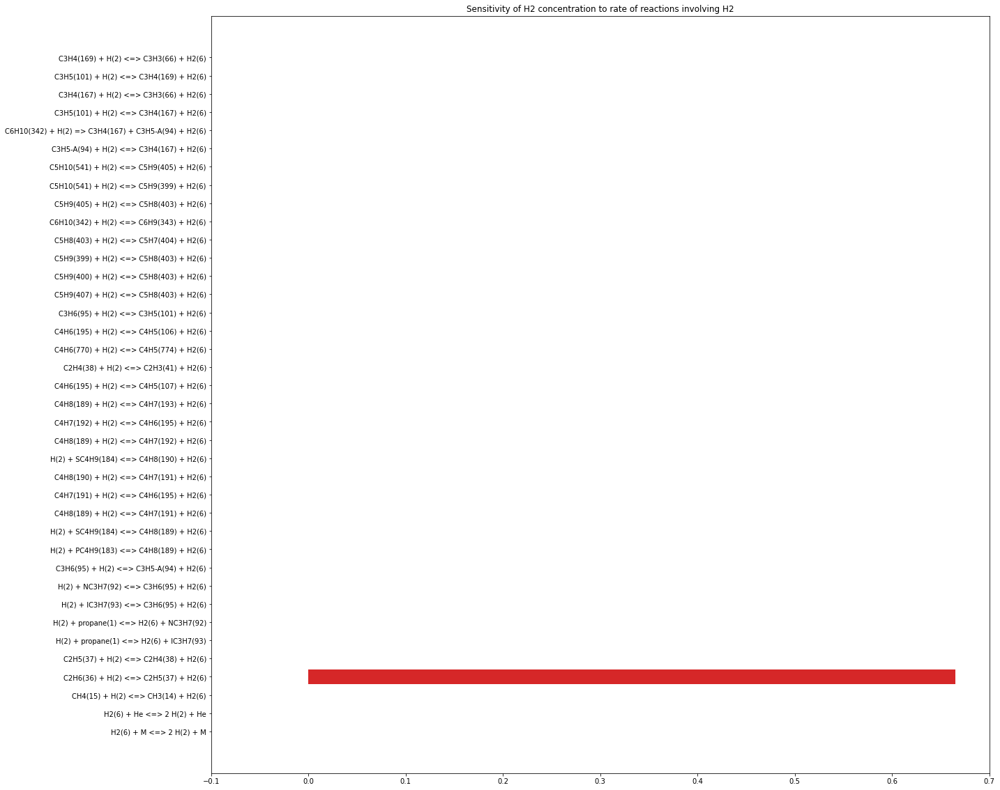

In [89]:
df_sens = pd.read_csv('./sensitivities.csv')
H2_sensitivities = df_sens[['s22',
 's23',
 's24',
 's25',
 's26',
 's27',
 's28',
 's43',
 's44',
 's51',
 's77',
 's83',
 's90',
 's104',
 's112',
 's118',
 's135',
 's155',
 's171',
 's189',
 's209',
 's245',
 's265',
 's296',
 's329',
 's344',
 's359',
 's372',
 's398',
 's438',
 's454',
 's455',
 's520',
 's530',
 's545',
 's570',
 's602',
 's609']]

for index, row in H2_sensitivities.iterrows():
    if index == 43:
        s22=row['s22']
        s23=row['s23']
        s24=row['s24']
        s25=row['s25']
        s26=row['s26']
        s27=row['s27']
        s28=row['s28']
        s43=row['s43']
        s44=row['s44']
        s51=row['s51']
        s77=row['s77']
        s83=row['s83']
        s90=row['s90']
        s104=row['s104']
        s112=row['s112']
        s118=row['s118']
        s135=row['s135']
        s155=row['s155']
        s171=row['s171']
        s189=row['s189']
        s209=row['s209']
        s245=row['s245']
        s265=row['s265']
        s296=row['s296']
        s329=row['s329']
        s344=row['s344']
        s359=row['s359']
        s372=row['s372']
        s398=row['s398']
        s438=row['s438']
        s454=row['s454']
        s455=row['s455']
        s520=row['s520']
        s530=row['s530']
        s545=row['s545']
        s570=row['s570']
        s602=row['s602']
        s609=row['s609']

plt.figure(figsize=(20,20))

plt.barh("H2(6) + M <=> 2 H(2) + M", s22)
plt.barh("H2(6) + He <=> 2 H(2) + He", s23)
plt.barh("CH4(15) + H(2) <=> CH3(14) + H2(6)", s24)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25)
plt.barh("C2H5(37) + H(2) <=> C2H4(38) + H2(6)", s26)
plt.barh("H(2) + propane(1) <=> H2(6) + IC3H7(93)", s27)
plt.barh("H(2) + propane(1) <=> H2(6) + NC3H7(92)", s28)
plt.barh("H(2) + IC3H7(93) <=> C3H6(95) + H2(6)", s43)
plt.barh("H(2) + NC3H7(92) <=> C3H6(95) + H2(6)", s44)
plt.barh("C3H6(95) + H(2) <=> C3H5-A(94) + H2(6)", s51)
plt.barh("H(2) + PC4H9(183) <=> C4H8(189) + H2(6)", s77)
plt.barh("H(2) + SC4H9(184) <=> C4H8(189) + H2(6)", s83)
plt.barh("C4H8(189) + H(2) <=> C4H7(191) + H2(6)", s90)
plt.barh("C4H7(191) + H(2) <=> C4H6(195) + H2(6)", s104)
plt.barh("C4H8(190) + H(2) <=> C4H7(191) + H2(6)", s112)
plt.barh("H(2) + SC4H9(184) <=> C4H8(190) + H2(6)", s118)
plt.barh("C4H8(189) + H(2) <=> C4H7(192) + H2(6)", s135)
plt.barh("C4H7(192) + H(2) <=> C4H6(195) + H2(6)", s155)
plt.barh("C4H8(189) + H(2) <=> C4H7(193) + H2(6)", s171)
plt.barh("C4H6(195) + H(2) <=> C4H5(107) + H2(6)", s189)
plt.barh("C2H4(38) + H(2) <=> C2H3(41) + H2(6)", s209)
plt.barh("C4H6(770) + H(2) <=> C4H5(774) + H2(6)", s245)
plt.barh("C4H6(195) + H(2) <=> C4H5(106) + H2(6)", s265)
plt.barh("C3H6(95) + H(2) <=> C3H5(101) + H2(6)", s296)
plt.barh("C5H9(407) + H(2) <=> C5H8(403) + H2(6)", s329)
plt.barh("C5H9(400) + H(2) <=> C5H8(403) + H2(6)", s344)
plt.barh("C5H9(399) + H(2) <=> C5H8(403) + H2(6)", s359)
plt.barh("C5H8(403) + H(2) <=> C5H7(404) + H2(6)", s372)
plt.barh("C6H10(342) + H(2) <=> C6H9(343) + H2(6)", s398)
plt.barh("C5H9(405) + H(2) <=> C5H8(403) + H2(6)", s438)
plt.barh("C5H10(541) + H(2) <=> C5H9(399) + H2(6)", s454)
plt.barh("C5H10(541) + H(2) <=> C5H9(405) + H2(6)", s455)
plt.barh("C3H5-A(94) + H(2) <=> C3H4(167) + H2(6)", s520)
plt.barh("C6H10(342) + H(2) => C3H4(167) + C3H5-A(94) + H2(6)", s530)
plt.barh("C3H5(101) + H(2) <=> C3H4(167) + H2(6)", s545)
plt.barh("C3H4(167) + H(2) <=> C3H3(66) + H2(6)", s570)
plt.barh("C3H5(101) + H(2) <=> C3H4(169) + H2(6)", s602)
plt.barh("C3H4(169) + H(2) <=> C3H3(66) + H2(6)", s609)
plt.xlim(-0.1,0.7)
plt.title('Sensitivity of H2 concentration to rate of reactions involving H2')

In [141]:
test = []
for index in H_rxns:
    #print(f"s{index}=row['s{index}']")
    #print(f's{index} = sim.sensitivity("H(2)", {index})')
    #test.append(f's{index}=s{index}')
    print(f'plt.barh("{gas.reactions()[index]}", s{index})')
', '.join(test)

plt.barh("CH3(14) + H(2) (+M) <=> CH4(15) (+M)", s15)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)", s17)
plt.barh("2 CH3(14) <=> C2H5(37) + H(2)", s18)
plt.barh("H(2) + NC3H7(92) <=> propane(1)", s19)
plt.barh("H(2) + IC3H7(93) <=> propane(1)", s20)
plt.barh("H(2) + IC3H7(93) <=> C2H5(37) + CH3(14)", s21)
plt.barh("H2(6) + M <=> 2 H(2) + M", s22)
plt.barh("H2(6) + He <=> 2 H(2) + He", s23)
plt.barh("CH4(15) + H(2) <=> CH3(14) + H2(6)", s24)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25)
plt.barh("C2H5(37) + H(2) <=> C2H4(38) + H2(6)", s26)
plt.barh("H(2) + propane(1) <=> H2(6) + IC3H7(93)", s27)
plt.barh("H(2) + propane(1) <=> H2(6) + NC3H7(92)", s28)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s29)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s30)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s31)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s32)
plt.barh("C3H6(95) + H(2) <=> IC3H7(93)", s33)
plt.barh("C3H6(95) 

''

Text(0.5, 1.0, 'Sensitivity of C2H6 concentration to rate of reactions involving C2H6')

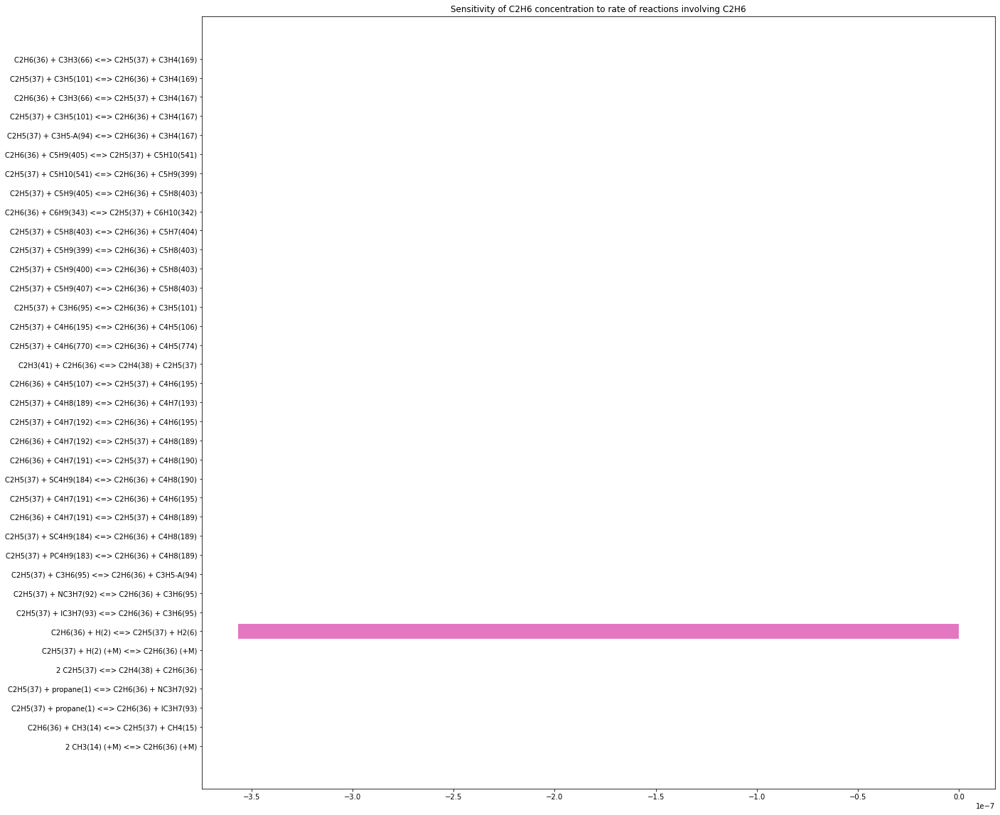

In [93]:
df_sens = pd.read_csv('./sensitivities.csv')
H2_sensitivities = df_sens[['s10',
 's11',
 's12',
 's13',
 's14',
 's16',
 's25_C',
 's36',
 's39',
 's53',
 's74',
 's80',
 's94',
 's105',
 's115',
 's125',
 's138',
 's154',
 's167',
 's192',
 's226',
 's241',
 's272',
 's299',
 's326',
 's341',
 's356',
 's374',
 's401',
 's437',
 's464',
 's490',
 's522',
 's542',
 's575',
 's617',
 's639']]

for index, row in H2_sensitivities.iterrows():
    if index == 43:
        s10=row['s10']
        s11=row['s11']
        s12=row['s12']
        s13=row['s13']
        s14=row['s14']
        s16=row['s16']
        s25_C=row['s25_C']
        s36=row['s36']
        s39=row['s39']
        s53=row['s53']
        s74=row['s74']
        s80=row['s80']
        s94=row['s94']
        s105=row['s105']
        s115=row['s115']
        s125=row['s125']
        s138=row['s138']
        s154=row['s154']
        s167=row['s167']
        s192=row['s192']
        s226=row['s226']
        s241=row['s241']
        s272=row['s272']
        s299=row['s299']
        s326=row['s326']
        s341=row['s341']
        s356=row['s356']
        s374=row['s374']
        s401=row['s401']
        s437=row['s437']
        s464=row['s464']
        s490=row['s490']
        s522=row['s522']
        s542=row['s542']
        s575=row['s575']
        s617=row['s617']
        s639=row['s639']

plt.figure(figsize=(20,20))

plt.barh("2 CH3(14) (+M) <=> C2H6(36) (+M)", s10)
plt.barh("C2H6(36) + CH3(14) <=> C2H5(37) + CH4(15)", s11)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + IC3H7(93)", s12)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + NC3H7(92)", s13)
plt.barh("2 C2H5(37) <=> C2H4(38) + C2H6(36)", s14)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25_C)
plt.barh("C2H5(37) + IC3H7(93) <=> C2H6(36) + C3H6(95)", s36)
plt.barh("C2H5(37) + NC3H7(92) <=> C2H6(36) + C3H6(95)", s39)
plt.barh("C2H5(37) + C3H6(95) <=> C2H6(36) + C3H5-A(94)", s53)
plt.barh("C2H5(37) + PC4H9(183) <=> C2H6(36) + C4H8(189)", s74)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(189)", s80)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(189)", s94)
plt.barh("C2H5(37) + C4H7(191) <=> C2H6(36) + C4H6(195)", s105)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(190)", s115)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(190)", s125)
plt.barh("C2H6(36) + C4H7(192) <=> C2H5(37) + C4H8(189)", s138)
plt.barh("C2H5(37) + C4H7(192) <=> C2H6(36) + C4H6(195)", s154)
plt.barh("C2H5(37) + C4H8(189) <=> C2H6(36) + C4H7(193)", s167)
plt.barh("C2H6(36) + C4H5(107) <=> C2H5(37) + C4H6(195)", s192)
plt.barh("C2H3(41) + C2H6(36) <=> C2H4(38) + C2H5(37)", s226)
plt.barh("C2H5(37) + C4H6(770) <=> C2H6(36) + C4H5(774)", s241)
plt.barh("C2H5(37) + C4H6(195) <=> C2H6(36) + C4H5(106)", s272)
plt.barh("C2H5(37) + C3H6(95) <=> C2H6(36) + C3H5(101)", s299)
plt.barh("C2H5(37) + C5H9(407) <=> C2H6(36) + C5H8(403)", s326)
plt.barh("C2H5(37) + C5H9(400) <=> C2H6(36) + C5H8(403)", s341)
plt.barh("C2H5(37) + C5H9(399) <=> C2H6(36) + C5H8(403)", s356)
plt.barh("C2H5(37) + C5H8(403) <=> C2H6(36) + C5H7(404)", s374)
plt.barh("C2H6(36) + C6H9(343) <=> C2H5(37) + C6H10(342)", s401)
plt.barh("C2H5(37) + C5H9(405) <=> C2H6(36) + C5H8(403)", s437)
plt.barh("C2H5(37) + C5H10(541) <=> C2H6(36) + C5H9(399)", s464)
plt.barh("C2H6(36) + C5H9(405) <=> C2H5(37) + C5H10(541)", s490)
plt.barh("C2H5(37) + C3H5-A(94) <=> C2H6(36) + C3H4(167)", s522)
plt.barh("C2H5(37) + C3H5(101) <=> C2H6(36) + C3H4(167)", s542)
plt.barh("C2H6(36) + C3H3(66) <=> C2H5(37) + C3H4(167)", s575)
plt.barh("C2H5(37) + C3H5(101) <=> C2H6(36) + C3H4(169)", s617)
plt.barh("C2H6(36) + C3H3(66) <=> C2H5(37) + C3H4(169)", s639)
#plt.xlim(-0.1,0.7)
plt.title('Sensitivity of C2H6 concentration to rate of reactions involving C2H6')

In [136]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm

x= 1/1000000 

mole_frac_dict = {'H(2)': x, 'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True


sim.rtol_sensitivity = 1.0e-6
sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t','s15',
 's16',
 's17',
 's18',
 's19',
 's20',
 's21',
 's22',
 's23',
 's24',
 's25',
 's26',
 's27',
 's28',
 's29',
 's30',
 's31',
 's32',
 's33',
 's34',
 's43',
 's44',
 's49',
 's50',
 's51',
 's62',
 's69',
 's70',
 's77',
 's83',
 's89',
 's90',
 's102',
 's104',
 's110',
 's111',
 's112',
 's118',
 's135',
 's137',
 's147',
 's155',
 's171',
 's177',
 's186',
 's188',
 's189',
 's208',
 's209',
 's213',
 's214',
 's222',
 's225',
 's239',
 's245',
 's255',
 's264',
 's265',
 's269',
 's271',
 's290',
 's291',
 's292',
 's293',
 's294',
 's295',
 's296',
 's322',
 's323',
 's324',
 's329',
 's344',
 's359',
 's371',
 's372',
 's398',
 's408',
 's420',
 's428',
 's438',
 's454',
 's455',
 's512',
 's513',
 's514',
 's520',
 's524',
 's525',
 's526',
 's527',
 's528',
 's530',
 's545',
 's570',
 's571',
 's574',
 's602',
 's604',
 's609',
 's611',
 's612',
 's613',
 's614',
 's615',
 's616'])

# enable sensitivity with respect to the rates of the first 10
# reactions (reactions 0 through 9)
for i in range(len(gas.reactions())):
    r.add_sensitivity_reaction(i)

dt_max = 1.e-5 
t_end = 1 * dt_max

while sim.time < t_end:
    sim.step()
    s15 = sim.sensitivity("H(2)", 15)
    s16 = sim.sensitivity("H(2)", 16)
    s17 = sim.sensitivity("H(2)", 17)
    s18 = sim.sensitivity("H(2)", 18)
    s19 = sim.sensitivity("H(2)", 19)
    s20 = sim.sensitivity("H(2)", 20)
    s21 = sim.sensitivity("H(2)", 21)
    s22 = sim.sensitivity("H(2)", 22)
    s23 = sim.sensitivity("H(2)", 23)
    s24 = sim.sensitivity("H(2)", 24)
    s25 = sim.sensitivity("H(2)", 25)
    s26 = sim.sensitivity("H(2)", 26)
    s27 = sim.sensitivity("H(2)", 27)
    s28 = sim.sensitivity("H(2)", 28)
    s29 = sim.sensitivity("H(2)", 29)
    s30 = sim.sensitivity("H(2)", 30)
    s31 = sim.sensitivity("H(2)", 31)
    s32 = sim.sensitivity("H(2)", 32)
    s33 = sim.sensitivity("H(2)", 33)
    s34 = sim.sensitivity("H(2)", 34)
    s43 = sim.sensitivity("H(2)", 43)
    s44 = sim.sensitivity("H(2)", 44)
    s49 = sim.sensitivity("H(2)", 49)
    s50 = sim.sensitivity("H(2)", 50)
    s51 = sim.sensitivity("H(2)", 51)
    s62 = sim.sensitivity("H(2)", 62)
    s69 = sim.sensitivity("H(2)", 69)
    s70 = sim.sensitivity("H(2)", 70)
    s77 = sim.sensitivity("H(2)", 77)
    s83 = sim.sensitivity("H(2)", 83)
    s89 = sim.sensitivity("H(2)", 89)
    s90 = sim.sensitivity("H(2)", 90)
    s102 = sim.sensitivity("H(2)", 102)
    s104 = sim.sensitivity("H(2)", 104)
    s110 = sim.sensitivity("H(2)", 110)
    s111 = sim.sensitivity("H(2)", 111)
    s112 = sim.sensitivity("H(2)", 112)
    s118 = sim.sensitivity("H(2)", 118)
    s135 = sim.sensitivity("H(2)", 135)
    s137 = sim.sensitivity("H(2)", 137)
    s147 = sim.sensitivity("H(2)", 147)
    s155 = sim.sensitivity("H(2)", 155)
    s171 = sim.sensitivity("H(2)", 171)
    s177 = sim.sensitivity("H(2)", 177)
    s186 = sim.sensitivity("H(2)", 186)
    s188 = sim.sensitivity("H(2)", 188)
    s189 = sim.sensitivity("H(2)", 189)
    s208 = sim.sensitivity("H(2)", 208)
    s209 = sim.sensitivity("H(2)", 209)
    s213 = sim.sensitivity("H(2)", 213)
    s214 = sim.sensitivity("H(2)", 214)
    s222 = sim.sensitivity("H(2)", 222)
    s225 = sim.sensitivity("H(2)", 225)
    s239 = sim.sensitivity("H(2)", 239)
    s245 = sim.sensitivity("H(2)", 245)
    s255 = sim.sensitivity("H(2)", 255)
    s264 = sim.sensitivity("H(2)", 264)
    s265 = sim.sensitivity("H(2)", 265)
    s269 = sim.sensitivity("H(2)", 269)
    s271 = sim.sensitivity("H(2)", 271)
    s290 = sim.sensitivity("H(2)", 290)
    s291 = sim.sensitivity("H(2)", 291)
    s292 = sim.sensitivity("H(2)", 292)
    s293 = sim.sensitivity("H(2)", 293)
    s294 = sim.sensitivity("H(2)", 294)
    s295 = sim.sensitivity("H(2)", 295)
    s296 = sim.sensitivity("H(2)", 296)
    s322 = sim.sensitivity("H(2)", 322)
    s323 = sim.sensitivity("H(2)", 323)
    s324 = sim.sensitivity("H(2)", 324)
    s329 = sim.sensitivity("H(2)", 329)
    s344 = sim.sensitivity("H(2)", 344)
    s359 = sim.sensitivity("H(2)", 359)
    s371 = sim.sensitivity("H(2)", 371)
    s372 = sim.sensitivity("H(2)", 372)
    s398 = sim.sensitivity("H(2)", 398)
    s408 = sim.sensitivity("H(2)", 408)
    s420 = sim.sensitivity("H(2)", 420)
    s428 = sim.sensitivity("H(2)", 428)
    s438 = sim.sensitivity("H(2)", 438)
    s454 = sim.sensitivity("H(2)", 454)
    s455 = sim.sensitivity("H(2)", 455)
    s512 = sim.sensitivity("H(2)", 512)
    s513 = sim.sensitivity("H(2)", 513)
    s514 = sim.sensitivity("H(2)", 514)
    s520 = sim.sensitivity("H(2)", 520)
    s524 = sim.sensitivity("H(2)", 524)
    s525 = sim.sensitivity("H(2)", 525)
    s526 = sim.sensitivity("H(2)", 526)
    s527 = sim.sensitivity("H(2)", 527)
    s528 = sim.sensitivity("H(2)", 528)
    s530 = sim.sensitivity("H(2)", 530)
    s545 = sim.sensitivity("H(2)", 545)
    s570 = sim.sensitivity("H(2)", 570)
    s571 = sim.sensitivity("H(2)", 571)
    s574 = sim.sensitivity("H(2)", 574)
    s602 = sim.sensitivity("H(2)", 602)
    s604 = sim.sensitivity("H(2)", 604)
    s609 = sim.sensitivity("H(2)", 609)
    s611 = sim.sensitivity("H(2)", 611)
    s612 = sim.sensitivity("H(2)", 612)
    s613 = sim.sensitivity("H(2)", 613)
    s614 = sim.sensitivity("H(2)", 614)
    s615 = sim.sensitivity("H(2)", 615)
    s616 = sim.sensitivity("H(2)", 616)
    states.append(r.thermo.state, t=sim.time*1e3, s15=s15, s16=s16, s17=s17, s18=s18, s19=s19, s20=s20, s21=s21, s22=s22, s23=s23, s24=s24, s25=s25, s26=s26, s27=s27, s28=s28, s29=s29, s30=s30, s31=s31, s32=s32, s33=s33, s34=s34, s43=s43, s44=s44, s49=s49, s50=s50, s51=s51, s62=s62, s69=s69, s70=s70, s77=s77, s83=s83, s89=s89, s90=s90, s102=s102, s104=s104, s110=s110, s111=s111, s112=s112, s118=s118, s135=s135, s137=s137, s147=s147, s155=s155, s171=s171, s177=s177, s186=s186, s188=s188, s189=s189, s208=s208, s209=s209, s213=s213, s214=s214, s222=s222, s225=s225, s239=s239, s245=s245, s255=s255, s264=s264, s265=s265, s269=s269, s271=s271, s290=s290, s291=s291, s292=s292, s293=s293, s294=s294, s295=s295, s296=s296, s322=s322, s323=s323, s324=s324, s329=s329, s344=s344, s359=s359, s371=s371, s372=s372, s398=s398, s408=s408, s420=s420, s428=s428, s438=s438, s454=s454, s455=s455, s512=s512, s513=s513, s514=s514, s520=s520, s524=s524, s525=s525, s526=s526, s527=s527, s528=s528, s530=s530, s545=s545, s570=s570, s571=s571, s574=s574, s602=s602, s604=s604, s609=s609, s611=s611, s612=s612, s613=s613, s614=s614, s615=s615, s616=s616)
states.to_pandas().to_csv('./edited_sensitivities.csv')

#after analyzing all the sensitivities, it is clear that reaction 25 

Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0


**If the true A factor for the key reaction was a factor of two larger than its value in the input file 
(e.g. due to an error in the measurement or calculation of A used to create the 
input file), how much larger than the model prediction would the true mole 
faction of H atoms at t be?**

the true mole fraction of H atoms at the previous half life time is now 2.5718320970526486e-07. Previously, the mole fraction was ~4.95-07 at this time. So this means the true rate is causing the mole fraction of H atoms to decrease twice as fast.  

In [158]:
diff = 4.95e-07/2.5718320970526486e-07 #old mole fraction at previous half life / new mole fraction at the previous half life
diff

1.9246979636317478

In [154]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm

x= 1/1000000 

mole_frac_dict = {'H(2)': x, 'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis_A_factor_doubled.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True

states = ct.SolutionArray(gas, extra='t')

dt_max = 1.e-5 
t_end = 1 * dt_max

while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3)

states.to_pandas().to_csv('./states_doubled.csv')

Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [155]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('H(2)')], states.t))
df.to_csv('./H_mole_fractions_doubled.csv')

# Question 1.d
**What happens at slightly longer times when the H atom mole fraction is no longer 
dropping rapidly? ***

There is an steady increase of H2(6) and C2H4(38).

Text(0, 0.5, 'mole fraction of H')

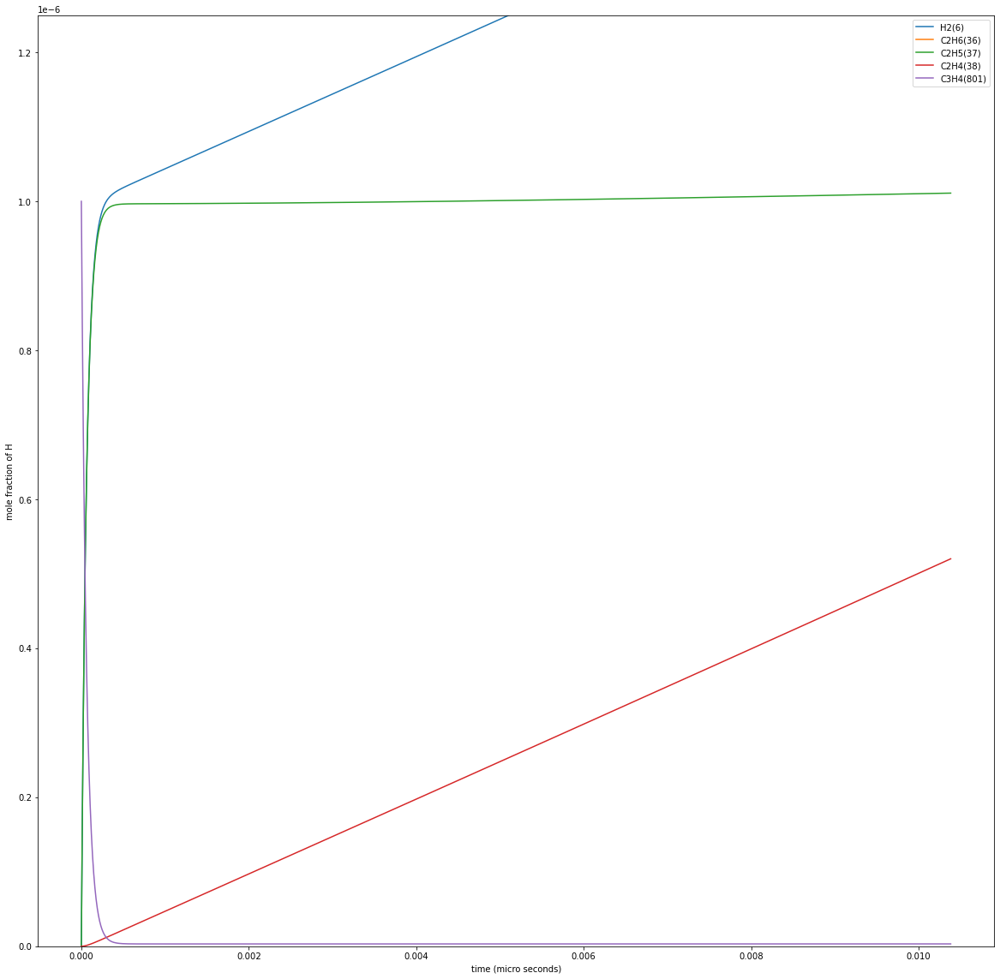

In [210]:
plt.figure(figsize=(20,20))

for spc in gas.species():
    if states.X[:,gas.species_index(spc.name)][-1] > 0.25e-7:
        plt.plot(states.t, states.X[:,gas.species_index(spc.name)], label=spc.name)
        
plt.plot(states.t, states.X[:,gas.species_index('H(2)')], label=spc.name)

    # else: 
    #     print(states.X[:,gas.species_index(spc.name)][-1])

plt.legend(bbox_to_anchor=(1,1))
plt.ylim(0,0.125e-5)
plt.xlabel('time (micro seconds)')
plt.ylabel('mole fraction of H')

**Use ROP analysis to see what reactions are turning on at these 
slightly longer times that stop the H atom concentration from continuing to drop.**

rxn #17 ( C2H4(38) + H(2) (+M) <=> C2H5(37) (+M) ) is turning on. 

In [211]:
#ROP analysis
#conditions 
T = 1000 #K
P = 1*ct.one_atm

x= 1/1000000 

mole_frac_dict = {'H(2)': x, 'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True

states = ct.SolutionArray(gas, extra='t')
columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]

dt_max = 1.e-5 
t_end = 1 * dt_max

while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3)
    #df_2 = pd.DataFrame(r.kinetics.net_rates_of_progress)
    rop_df.append(r.kinetics.net_rates_of_progress)


Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [212]:
df_rop = pd.DataFrame(rop_df)
df_rop.to_csv('./rop.csv')

Text(0.5, 1.0, 'Net production rates of all reactions over time')

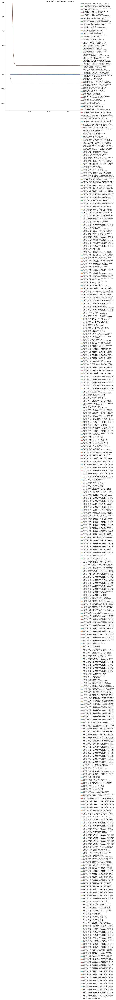

In [236]:
plt.figure(figsize=(20,20))
for column in df_rop: 
    rop = df_rop[column].to_list()
    #if float(rop[-1])<-0.00025:
    plt.plot(states.t, [float(x) for x in rop[1:]], label = rop[0])
plt.legend()
plt.ylim(-0.0025, 0.005)
plt.title('Net production rates of all reactions over time')
    

**Is the H atom concentration stabilizing towards a value set by an equilibrium or 
by a steady-state, or is something else happening? 

The H atoms are being consumed in one reaction ( C2H6(36) + H(2) <=> C2H5(37) + H2(6) ) and generated in another recently turned-on reaction ( C2H4(38) + H(2) (+M) <=> C2H5(37) (+M) ). This is why the H atom concentration is stabilizing. 


involved in the reaction that is now turning on. They are now being generated as fast as they are being consumed

**Does sensitivity analysis at this 
somewhat longer time identify the same important reactions as the ROP analysis?**

Yes, the sensitivity plot below shows this rxn ( C2H4(38) + H(2) (+M) <=> C2H5(37) (+M) )  is turning on. 

Text(0.5, 1.0, 'Sensitivity of H concentration to rate of reactions involving H')

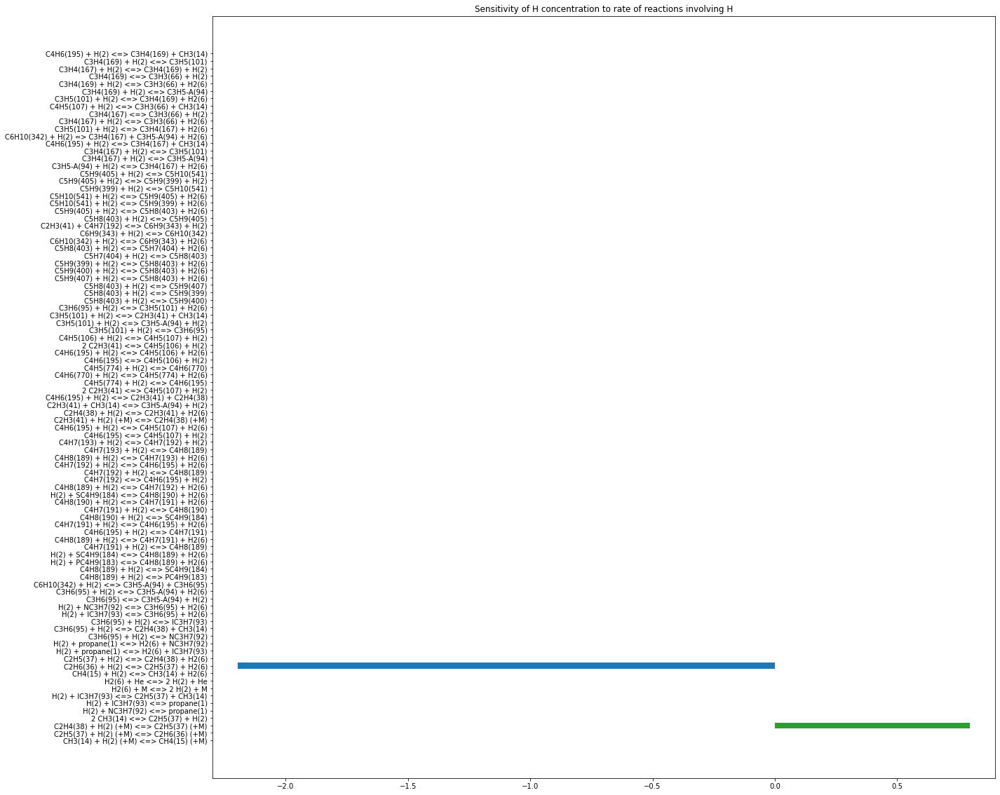

In [245]:
df_sens = pd.read_csv('./edited_sensitivities.csv')
H2_sensitivities = df_sens[['s15',
's16',
's17',
's18',
's19',
's20',
's21',
's22',
's23',
's24',
's25',
's26',
's27',
's28',
's29',
's30',
's31',
's32',
's33',
's34',
's43',
's44',
's49',
's50',
's51',
's62',
's69',
's70',
's77',
's83',
's89',
's90',
's102',
's104',
's110',
's111',
's112',
's118',
's135',
's137',
's147',
's155',
's171',
's177',
's186',
's188',
's189',
's208',
's209',
's213',
's214',
's222',
's225',
's239',
's245',
's255',
's264',
's265',
's269',
's271',
's290',
's291',
's292',
's293',
's294',
's295',
's296',
's322',
's323',
's324',
's329',
's344',
's359',
's371',
's372',
's398',
's408',
's420',
's428',
's438',
's454',
's455',
's512',
's513',
's514',
's520',
's524',
's525',
's526',
's527',
's528',
's530',
's545',
's570',
's571',
's574',
's602',
's604',
's609',
's611',
's612',
's613',
's614',
's615',
's616']]

for index, row in H2_sensitivities.iterrows():
    if index == 200:
        s15=row['s15']
        s16=row['s16']
        s17=row['s17']
        s18=row['s18']
        s19=row['s19']
        s20=row['s20']
        s21=row['s21']
        s22=row['s22']
        s23=row['s23']
        s24=row['s24']
        s25=row['s25']
        s26=row['s26']
        s27=row['s27']
        s28=row['s28']
        s29=row['s29']
        s30=row['s30']
        s31=row['s31']
        s32=row['s32']
        s33=row['s33']
        s34=row['s34']
        s43=row['s43']
        s44=row['s44']
        s49=row['s49']
        s50=row['s50']
        s51=row['s51']
        s62=row['s62']
        s69=row['s69']
        s70=row['s70']
        s77=row['s77']
        s83=row['s83']
        s89=row['s89']
        s90=row['s90']
        s102=row['s102']
        s104=row['s104']
        s110=row['s110']
        s111=row['s111']
        s112=row['s112']
        s118=row['s118']
        s135=row['s135']
        s137=row['s137']
        s147=row['s147']
        s155=row['s155']
        s171=row['s171']
        s177=row['s177']
        s186=row['s186']
        s188=row['s188']
        s189=row['s189']
        s208=row['s208']
        s209=row['s209']
        s213=row['s213']
        s214=row['s214']
        s222=row['s222']
        s225=row['s225']
        s239=row['s239']
        s245=row['s245']
        s255=row['s255']
        s264=row['s264']
        s265=row['s265']
        s269=row['s269']
        s271=row['s271']
        s290=row['s290']
        s291=row['s291']
        s292=row['s292']
        s293=row['s293']
        s294=row['s294']
        s295=row['s295']
        s296=row['s296']
        s322=row['s322']
        s323=row['s323']
        s324=row['s324']
        s329=row['s329']
        s344=row['s344']
        s359=row['s359']
        s371=row['s371']
        s372=row['s372']
        s398=row['s398']
        s408=row['s408']
        s420=row['s420']
        s428=row['s428']
        s438=row['s438']
        s454=row['s454']
        s455=row['s455']
        s512=row['s512']
        s513=row['s513']
        s514=row['s514']
        s520=row['s520']
        s524=row['s524']
        s525=row['s525']
        s526=row['s526']
        s527=row['s527']
        s528=row['s528']
        s530=row['s530']
        s545=row['s545']
        s570=row['s570']
        s571=row['s571']
        s574=row['s574']
        s602=row['s602']
        s604=row['s604']
        s609=row['s609']
        s611=row['s611']
        s612=row['s612']
        s613=row['s613']
        s614=row['s614']
        s615=row['s615']
        s616=row['s616']

plt.figure(figsize=(20,20))

plt.barh("CH3(14) + H(2) (+M) <=> CH4(15) (+M)", s15)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)", s17)
plt.barh("2 CH3(14) <=> C2H5(37) + H(2)", s18)
plt.barh("H(2) + NC3H7(92) <=> propane(1)", s19)
plt.barh("H(2) + IC3H7(93) <=> propane(1)", s20)
plt.barh("H(2) + IC3H7(93) <=> C2H5(37) + CH3(14)", s21)
plt.barh("H2(6) + M <=> 2 H(2) + M", s22)
plt.barh("H2(6) + He <=> 2 H(2) + He", s23)
plt.barh("CH4(15) + H(2) <=> CH3(14) + H2(6)", s24)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25)
plt.barh("C2H5(37) + H(2) <=> C2H4(38) + H2(6)", s26)
plt.barh("H(2) + propane(1) <=> H2(6) + IC3H7(93)", s27)
plt.barh("H(2) + propane(1) <=> H2(6) + NC3H7(92)", s28)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s29)
plt.barh("C3H6(95) + H(2) <=> NC3H7(92)", s30)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s31)
plt.barh("C3H6(95) + H(2) <=> C2H4(38) + CH3(14)", s32)
plt.barh("C3H6(95) + H(2) <=> IC3H7(93)", s33)
plt.barh("C3H6(95) + H(2) <=> IC3H7(93)", s34)
plt.barh("H(2) + IC3H7(93) <=> C3H6(95) + H2(6)", s43)
plt.barh("H(2) + NC3H7(92) <=> C3H6(95) + H2(6)", s44)
plt.barh("C3H6(95) <=> C3H5-A(94) + H(2)", s49)
plt.barh("C3H6(95) <=> C3H5-A(94) + H(2)", s50)
plt.barh("C3H6(95) + H(2) <=> C3H5-A(94) + H2(6)", s51)
plt.barh("C6H10(342) + H(2) <=> C3H5-A(94) + C3H6(95)", s62)
plt.barh("C4H8(189) + H(2) <=> PC4H9(183)", s69)
plt.barh("C4H8(189) + H(2) <=> SC4H9(184)", s70)
plt.barh("H(2) + PC4H9(183) <=> C4H8(189) + H2(6)", s77)
plt.barh("H(2) + SC4H9(184) <=> C4H8(189) + H2(6)", s83)
plt.barh("C4H7(191) + H(2) <=> C4H8(189)", s89)
plt.barh("C4H8(189) + H(2) <=> C4H7(191) + H2(6)", s90)
plt.barh("C4H6(195) + H(2) <=> C4H7(191)", s102)
plt.barh("C4H7(191) + H(2) <=> C4H6(195) + H2(6)", s104)
plt.barh("C4H8(190) + H(2) <=> SC4H9(184)", s110)
plt.barh("C4H7(191) + H(2) <=> C4H8(190)", s111)
plt.barh("C4H8(190) + H(2) <=> C4H7(191) + H2(6)", s112)
plt.barh("H(2) + SC4H9(184) <=> C4H8(190) + H2(6)", s118)
plt.barh("C4H8(189) + H(2) <=> C4H7(192) + H2(6)", s135)
plt.barh("C4H7(192) <=> C4H6(195) + H(2)", s137)
plt.barh("C4H7(192) + H(2) <=> C4H8(189)", s147)
plt.barh("C4H7(192) + H(2) <=> C4H6(195) + H2(6)", s155)
plt.barh("C4H8(189) + H(2) <=> C4H7(193) + H2(6)", s171)
plt.barh("C4H7(193) + H(2) <=> C4H8(189)", s177)
plt.barh("C4H7(193) + H(2) <=> C4H7(192) + H(2)", s186)
plt.barh("C4H6(195) <=> C4H5(107) + H(2)", s188)
plt.barh("C4H6(195) + H(2) <=> C4H5(107) + H2(6)", s189)
plt.barh("C2H3(41) + H(2) (+M) <=> C2H4(38) (+M)", s208)
plt.barh("C2H4(38) + H(2) <=> C2H3(41) + H2(6)", s209)
plt.barh("C2H3(41) + CH3(14) <=> C3H5-A(94) + H(2)", s213)
plt.barh("C2H3(41) + CH3(14) <=> C3H5-A(94) + H(2)", s214)
plt.barh("C4H6(195) + H(2) <=> C2H3(41) + C2H4(38)", s222)
plt.barh("2 C2H3(41) <=> C4H5(107) + H(2)", s225)
plt.barh("C4H5(774) + H(2) <=> C4H6(195)", s239)
plt.barh("C4H6(770) + H(2) <=> C4H5(774) + H2(6)", s245)
plt.barh("C4H5(774) + H(2) <=> C4H6(770)", s255)
plt.barh("C4H6(195) <=> C4H5(106) + H(2)", s264)
plt.barh("C4H6(195) + H(2) <=> C4H5(106) + H2(6)", s265)
plt.barh("2 C2H3(41) <=> C4H5(106) + H(2)", s269)
plt.barh("C4H5(106) + H(2) <=> C4H5(107) + H(2)", s271)
plt.barh("C3H5(101) + H(2) <=> C3H6(95)", s290)
plt.barh("C3H5(101) + H(2) <=> C3H6(95)", s291)
plt.barh("C3H5(101) + H(2) <=> C3H5-A(94) + H(2)", s292)
plt.barh("C3H5(101) + H(2) <=> C3H5-A(94) + H(2)", s293)
plt.barh("C3H5(101) + H(2) <=> C2H3(41) + CH3(14)", s294)
plt.barh("C3H5(101) + H(2) <=> C2H3(41) + CH3(14)", s295)
plt.barh("C3H6(95) + H(2) <=> C3H5(101) + H2(6)", s296)
plt.barh("C5H8(403) + H(2) <=> C5H9(400)", s322)
plt.barh("C5H8(403) + H(2) <=> C5H9(399)", s323)
plt.barh("C5H8(403) + H(2) <=> C5H9(407)", s324)
plt.barh("C5H9(407) + H(2) <=> C5H8(403) + H2(6)", s329)
plt.barh("C5H9(400) + H(2) <=> C5H8(403) + H2(6)", s344)
plt.barh("C5H9(399) + H(2) <=> C5H8(403) + H2(6)", s359)
plt.barh("C5H7(404) + H(2) <=> C5H8(403)", s371)
plt.barh("C5H8(403) + H(2) <=> C5H7(404) + H2(6)", s372)
plt.barh("C6H10(342) + H(2) <=> C6H9(343) + H2(6)", s398)
plt.barh("C6H9(343) + H(2) <=> C6H10(342)", s408)
plt.barh("C2H3(41) + C4H7(192) <=> C6H9(343) + H(2)", s420)
plt.barh("C5H8(403) + H(2) <=> C5H9(405)", s428)
plt.barh("C5H9(405) + H(2) <=> C5H8(403) + H2(6)", s438)
plt.barh("C5H10(541) + H(2) <=> C5H9(399) + H2(6)", s454)
plt.barh("C5H10(541) + H(2) <=> C5H9(405) + H2(6)", s455)
plt.barh("C5H9(399) + H(2) <=> C5H10(541)", s512)
plt.barh("C5H9(405) + H(2) <=> C5H9(399) + H(2)", s513)
plt.barh("C5H9(405) + H(2) <=> C5H10(541)", s514)
plt.barh("C3H5-A(94) + H(2) <=> C3H4(167) + H2(6)", s520)
plt.barh("C3H4(167) + H(2) <=> C3H5-A(94)", s524)
plt.barh("C3H4(167) + H(2) <=> C3H5-A(94)", s525)
plt.barh("C3H4(167) + H(2) <=> C3H5(101)", s526)
plt.barh("C3H4(167) + H(2) <=> C3H5(101)", s527)
plt.barh("C4H6(195) + H(2) <=> C3H4(167) + CH3(14)", s528)
plt.barh("C6H10(342) + H(2) => C3H4(167) + C3H5-A(94) + H2(6)", s530)
plt.barh("C3H5(101) + H(2) <=> C3H4(167) + H2(6)", s545)
plt.barh("C3H4(167) + H(2) <=> C3H3(66) + H2(6)", s570)
plt.barh("C3H4(167) <=> C3H3(66) + H(2)", s571)
plt.barh("C4H5(107) + H(2) <=> C3H3(66) + CH3(14)", s574)
plt.barh("C3H5(101) + H(2) <=> C3H4(169) + H2(6)", s602)
plt.barh("C3H4(169) + H(2) <=> C3H5-A(94)", s604)
plt.barh("C3H4(169) + H(2) <=> C3H3(66) + H2(6)", s609)
plt.barh("C3H4(169) <=> C3H3(66) + H(2)", s611)
plt.barh("C3H4(167) + H(2) <=> C3H4(169) + H(2)", s612)
plt.barh("C3H4(167) + H(2) <=> C3H4(169) + H(2)", s613)
plt.barh("C3H4(169) + H(2) <=> C3H5(101)", s614)
plt.barh("C3H4(169) + H(2) <=> C3H5(101)", s615)
plt.barh("C4H6(195) + H(2) <=> C3H4(169) + CH3(14)", s616)


plt.xlim(-2.3,.9)
plt.title('Sensitivity of H concentration to rate of reactions involving H')

# Question 2.a

**Now simulate a system of pure ethane (no initial H atoms) at 1000 K and 1 
atm. This is one of the most important and largest-volume commercial 
chemical reactions; ethane is a major component in natural gas, and the 
desired product ethene (C2H4) is the key ingredient used for making many 
man-made materials. Run the simulation until the mole fraction of ethane has 
dropped approximately in half – what is its half-life in this system?**

1.722 seconds


**Plot the log of the C2H6 mole fraction versus time – is it a straight line, or not? Is 
C2H6 decay a pseudo-first-order process?**

Yes, the plot shows a somewhat straight line after some microseconds. 

Text(0.5, 1.0, 'Log of mole fraction of ethane versus time')

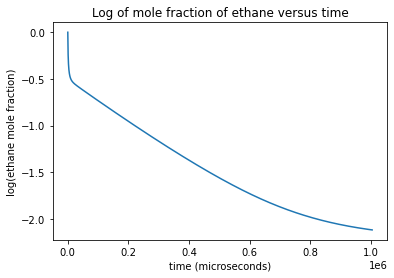

In [311]:
plt.plot(states.t, np.log10(states.X[:,gas.species_index('C2H6(36)')]))
#plt.plot(states.t, states.X[:,gas.species_index('C2H6(36)')])
#plt.ylim(0,1)
#plt.xlim(0,100000)
plt.xlabel('time (microseconds)')
plt.ylabel('log(ethane mole fraction)')
plt.title('Log of mole fraction of ethane versus time')

# Question 2.b

**(b) Make a Flux Diagram at that time-point and from it and ROP analyses write 
down the main sequence of balanced reactions that is converting C2H6 into 
C2H4. What is the main reaction consuming C2H6 at that time point?** 

attach .png file. The main sequence of reactions converting C2H6 to C2H4 is:


* 2 C2H5(37) <=> C2H4(38) + C2H6(36)
* C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)
* C2H6(36) + H(2) <=> C2H5(37) + H2(6)


The main reaction consuming C2H6 at this point is C2H6(36) + H(2) <=> C2H5(37) + H2(6). 

In [263]:
gas = ct.Solution('./propanepyrolysis.cti')
mole_frac_dict = {'C2H6(36)': 1}
T = 1000 #K
P = 1*ct.one_atm
gas.TPX = T, P, mole_frac_dict

 
# Define the element to follow in the reaction path diagram:
element = 'H'
 
# Initiate the reaction path diagram:
diagram = ct.ReactionPathDiagram(gas, element)
 
# Define the filenames:
dot_file = 'ReactionPathDiagram_pureEthane.dot'
img_file = 'ReactionPathDiagram_pureEthane.png'
 
# Write the dot-file first, then create the image from the dot-file with customizable
# parameters:
diagram.write_dot(dot_file)
os.system('dot {0} -Tpng -o{1} -Gdpi=300'.format(dot_file, img_file))

0

In [333]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm


mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis_A_factor_doubled.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True

states = ct.SolutionArray(gas, extra='t')

dt_max = 1.e-5 
t_end = 100000000 * dt_max

while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3)

states.to_pandas().to_csv('./states_pure_ethane.csv')

Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [334]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('C2H6(36)')], states.t))
df.to_csv('./C2H6_mole_fractions.csv')

In [335]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm


mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True


sim.rtol_sensitivity = 1.0e-6
sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])

# enable sensitivity with respect to the rates of the first 10
# reactions (reactions 0 through 9)
for i in range(len(gas.reactions())):
    r.add_sensitivity_reaction(i)

dt_max = 1.e-5 
t_end = 100000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]
sens_all_reactions = [columns]

count=0
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    rop_df.append(r.kinetics.net_rates_of_progress)
    sensitivities = []
    for index, rxn in enumerate(gas.reactions()):
        sens = sim.sensitivity('C2H6(36)', index)
        sensitivities.append(sens)
    sens_all_reactions.append(sensitivities)
    count+=1
print(count)
states.to_pandas().to_csv('./sensitivities_pureEthane.csv')

#after analyzing all the sensitivities, it is clear that reaction 25 

Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0
1985


In [336]:
df_sens = pd.DataFrame(sens_all_reactions)
df_sens.to_csv('./sens_all_rxns_pureEthane.csv')

/home/khalil.nor/.conda/envs/cantera_env/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,2

propane(1) (+M) <=> C2H5(37) + CH3(14) (+M)
2 CH3(14) (+M) <=> C2H6(36) (+M)
2 C2H5(37) <=> C2H4(38) + C2H6(36)
C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)
C2H6(36) + H(2) <=> C2H5(37) + H2(6)


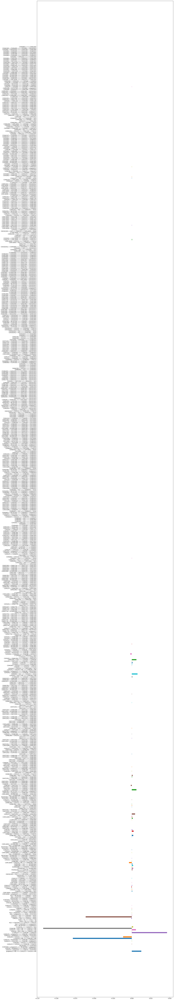

In [359]:
plt.figure(figsize=(20,150))
all_rxns_sens = pd.read_csv('./sens_all_rxns_pureEthane.csv')
for index, row in all_rxns_sens.iterrows():
    if index == 717:
        for index,column in zip(list(range(0,669)),row):
            if index==0:
                continue
            else:
                plt.barh(str(gas.reactions()[index-1]), float(column))
            if float(column) < -0.05:
                print(gas.reactions()[index-1])
            if float(column) > 0.01:
                print(gas.reactions()[index-1])


        

In [270]:
test = []
for index in C2H6_rxns:
    #print(f"s{index}=row['s{index}']")
    #print(f's{index} = sim.sensitivity("C2H6(36)", {index})')
    #test.append(f's{index}=s{index}')
    print(f'plt.barh("{gas.reactions()[index]}", s{index})')
', '.join(test)

plt.barh("2 CH3(14) (+M) <=> C2H6(36) (+M)", s10)
plt.barh("C2H6(36) + CH3(14) <=> C2H5(37) + CH4(15)", s11)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + IC3H7(93)", s12)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + NC3H7(92)", s13)
plt.barh("2 C2H5(37) <=> C2H4(38) + C2H6(36)", s14)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25)
plt.barh("C2H5(37) + IC3H7(93) <=> C2H6(36) + C3H6(95)", s36)
plt.barh("C2H5(37) + NC3H7(92) <=> C2H6(36) + C3H6(95)", s39)
plt.barh("C2H5(37) + C3H6(95) <=> C2H6(36) + C3H5-A(94)", s53)
plt.barh("C2H5(37) + PC4H9(183) <=> C2H6(36) + C4H8(189)", s74)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(189)", s80)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(189)", s94)
plt.barh("C2H5(37) + C4H7(191) <=> C2H6(36) + C4H6(195)", s105)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(190)", s115)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(190)", s125)
plt.barh("C2H6(36) + C4H7(192)

''

Text(0.5, 1.0, 'Sensitivity of C2H6 concentration to rate of reactions involving C2H6')

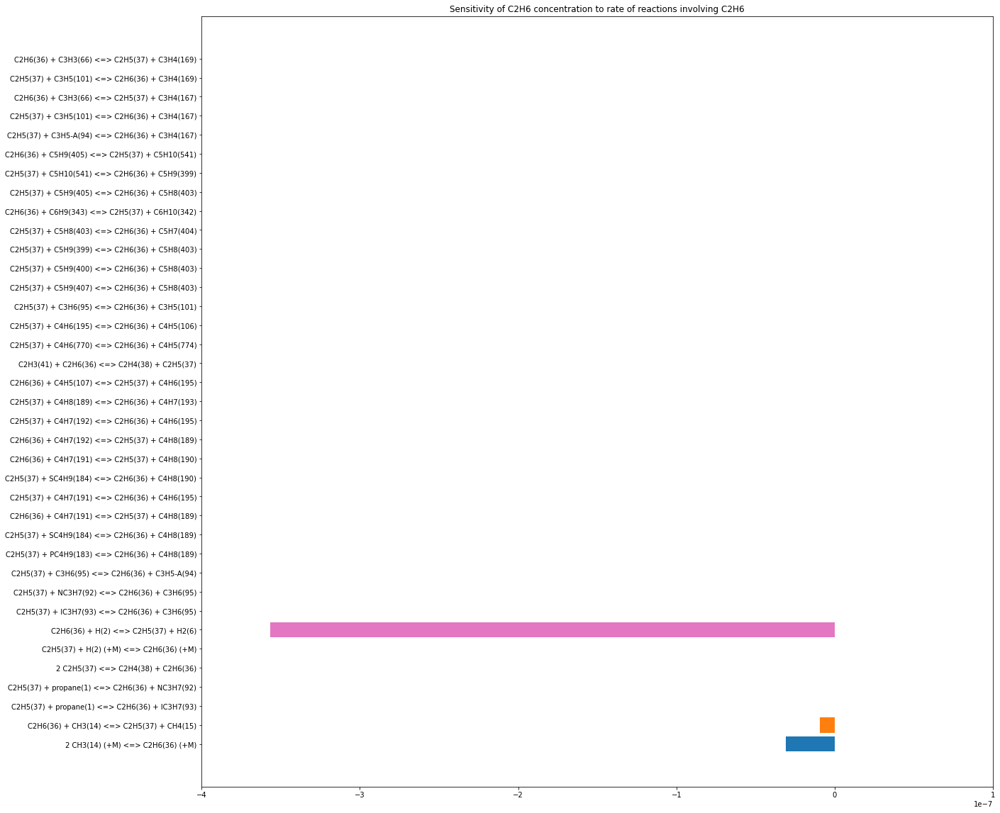

In [312]:
df_sens = pd.read_csv('./sensitivities_pureEthane.csv')
C2H6_sensitivities = df_sens[['s10',
 's11',
 's12',
 's13',
 's14',
 's16',
 's25',
 's36',
 's39',
 's53',
 's74',
 's80',
 's94',
 's105',
 's115',
 's125',
 's138',
 's154',
 's167',
 's192',
 's226',
 's241',
 's272',
 's299',
 's326',
 's341',
 's356',
 's374',
 's401',
 's437',
 's464',
 's490',
 's522',
 's542',
 's575',
 's617',
 's639']]

for index, row in C2H6_sensitivities.iterrows():
    if index == 718:
        s10=row['s10']
        s11=row['s11']
        s12=row['s12']
        s13=row['s13']
        s14=row['s14']
        s16=row['s16']
        s25_C=row['s25']
        s36=row['s36']
        s39=row['s39']
        s53=row['s53']
        s74=row['s74']
        s80=row['s80']
        s94=row['s94']
        s105=row['s105']
        s115=row['s115']
        s125=row['s125']
        s138=row['s138']
        s154=row['s154']
        s167=row['s167']
        s192=row['s192']
        s226=row['s226']
        s241=row['s241']
        s272=row['s272']
        s299=row['s299']
        s326=row['s326']
        s341=row['s341']
        s356=row['s356']
        s374=row['s374']
        s401=row['s401']
        s437=row['s437']
        s464=row['s464']
        s490=row['s490']
        s522=row['s522']
        s542=row['s542']
        s575=row['s575']
        s617=row['s617']
        s639=row['s639']

plt.figure(figsize=(20,20))

plt.barh("2 CH3(14) (+M) <=> C2H6(36) (+M)", s10)
plt.barh("C2H6(36) + CH3(14) <=> C2H5(37) + CH4(15)", s11)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + IC3H7(93)", s12)
plt.barh("C2H5(37) + propane(1) <=> C2H6(36) + NC3H7(92)", s13)
plt.barh("2 C2H5(37) <=> C2H4(38) + C2H6(36)", s14)
plt.barh("C2H5(37) + H(2) (+M) <=> C2H6(36) (+M)", s16)
plt.barh("C2H6(36) + H(2) <=> C2H5(37) + H2(6)", s25_C)
plt.barh("C2H5(37) + IC3H7(93) <=> C2H6(36) + C3H6(95)", s36)
plt.barh("C2H5(37) + NC3H7(92) <=> C2H6(36) + C3H6(95)", s39)
plt.barh("C2H5(37) + C3H6(95) <=> C2H6(36) + C3H5-A(94)", s53)
plt.barh("C2H5(37) + PC4H9(183) <=> C2H6(36) + C4H8(189)", s74)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(189)", s80)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(189)", s94)
plt.barh("C2H5(37) + C4H7(191) <=> C2H6(36) + C4H6(195)", s105)
plt.barh("C2H5(37) + SC4H9(184) <=> C2H6(36) + C4H8(190)", s115)
plt.barh("C2H6(36) + C4H7(191) <=> C2H5(37) + C4H8(190)", s125)
plt.barh("C2H6(36) + C4H7(192) <=> C2H5(37) + C4H8(189)", s138)
plt.barh("C2H5(37) + C4H7(192) <=> C2H6(36) + C4H6(195)", s154)
plt.barh("C2H5(37) + C4H8(189) <=> C2H6(36) + C4H7(193)", s167)
plt.barh("C2H6(36) + C4H5(107) <=> C2H5(37) + C4H6(195)", s192)
plt.barh("C2H3(41) + C2H6(36) <=> C2H4(38) + C2H5(37)", s226)
plt.barh("C2H5(37) + C4H6(770) <=> C2H6(36) + C4H5(774)", s241)
plt.barh("C2H5(37) + C4H6(195) <=> C2H6(36) + C4H5(106)", s272)
plt.barh("C2H5(37) + C3H6(95) <=> C2H6(36) + C3H5(101)", s299)
plt.barh("C2H5(37) + C5H9(407) <=> C2H6(36) + C5H8(403)", s326)
plt.barh("C2H5(37) + C5H9(400) <=> C2H6(36) + C5H8(403)", s341)
plt.barh("C2H5(37) + C5H9(399) <=> C2H6(36) + C5H8(403)", s356)
plt.barh("C2H5(37) + C5H8(403) <=> C2H6(36) + C5H7(404)", s374)
plt.barh("C2H6(36) + C6H9(343) <=> C2H5(37) + C6H10(342)", s401)
plt.barh("C2H5(37) + C5H9(405) <=> C2H6(36) + C5H8(403)", s437)
plt.barh("C2H5(37) + C5H10(541) <=> C2H6(36) + C5H9(399)", s464)
plt.barh("C2H6(36) + C5H9(405) <=> C2H5(37) + C5H10(541)", s490)
plt.barh("C2H5(37) + C3H5-A(94) <=> C2H6(36) + C3H4(167)", s522)
plt.barh("C2H5(37) + C3H5(101) <=> C2H6(36) + C3H4(167)", s542)
plt.barh("C2H6(36) + C3H3(66) <=> C2H5(37) + C3H4(167)", s575)
plt.barh("C2H5(37) + C3H5(101) <=> C2H6(36) + C3H4(169)", s617)
plt.barh("C2H6(36) + C3H3(66) <=> C2H5(37) + C3H4(169)", s639)
plt.xlim(-4e-7,1e-7)
plt.title('Sensitivity of C2H6 concentration to rate of reactions involving C2H6')

# Question 2.c

**Do a sensitivity analysis at that time-point to see which rate coefficients affect 
the predicted mole-fraction of C2H6.  Is the conversion of C2H6 very 
sensitive to the main reaction you identified in part (b)?**

Sensitivity analysis above. Yes, conversion of C2H6 is very sensitive to the main reaction identified above (C2H6(36) + H(2) <=> C2H5(37) + H2(6)). 

**Is the conversion of C2H6 more sensitive to other reaction(s) in the main sequence?**

Yes, it is more sensitive to the following two reactions:

* 2 CH3(14) (+M) <=> C2H6(36) (+M)
* C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)

**Does the sensitivity analysis identify any reactions as being important that do not show 
up at all in Part (b)? What are these extra reactions doing?**

Yes, the following reactions are coming up as being important: 

* **propane(1) (+M) <=> C2H5(37) + CH3(14) (+M)**
* **2 CH3(14) (+M) <=> C2H6(36) (+M)**
* 2 C2H5(37) <=> C2H4(38) + C2H6(36)
* C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)
* C2H6(36) + H(2) <=> C2H5(37) + H2(6)

with the first 2 in this list not showing up in part B. These reactions are consuming the desired product.  

# Question 2.d

**If you run this reaction at P=2 atm, pure ethane, is the half-life of ethane 
longer or shorter than at P=1 atm? Why?**

Half life of ethane at P=2 atm is 3.474 seconds, so it is longer. This is because some of the reactions mentioned above are pressure dependent. Thus, with increased pressure, they will react at greater rates and take away from the main sequence of reactions consuming C2H6, or may even be regenerating C2H6.  

# Question 2.e

**If you run this reaction at P=2 atm, but the initial composition is 50% ethane 
and 50% He, is the ethane half-life longer or shorter or the same as the case 
with pure ethane at P=1 atm? Note that in these two cases the initial 
concentration of ethane is identical. Also note that the He is completely inert. 
Speculate about what is causing any difference between the two cases.** 

In this new system with He, the half life has increased to 3.842 seconds. This is likely because the He molecules are acting as additional third bodies that will increase the likelihood of third-body collisions in the extra pressure dependent reactions, which is further decreasing the conversion of C2H6, just as changing the pressure did in part D. 

# Question 2.f

**One expects the reaction kinetics to lead to chemical equilibrium. What is the 
equilibrium distribution of the species in the model, if one starts from pure 
ethane, and holds the system at 1000 K and 1 atm?**

In [144]:
#conditions 
T = 1000 #K
P = 2*ct.one_atm


mole_frac_dict = {'C2H6(36)': 1, 'He': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases
#mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict
#gas.equilibrate('TP')

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True


sim.rtol_sensitivity = 1.0e-6
sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])



dt_max = 1.e-5 
t_end = 100000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]

count=0
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)

print(count)


Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0
0


In [146]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('C2H6(36)')], states.t))
df.to_csv('./C2H6_mole_fractions_2atm_He.csv')

In [377]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm


#mole_frac_dict = {'C2H6(36)': 1, 'He': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases
mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict
gas.equilibrate('TP')

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
sim = ct.ReactorNet([r]) 
sim.verbose = True


sim.rtol_sensitivity = 1.0e-6
sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])



dt_max = 1.e-5 
t_end = 100000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]

count=0
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time*1e3) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)

print(count)


Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0
0


In [398]:
pd.DataFrame([x.name for x in gas.species()],gas.concentrations)# concentrations at equilibrium 

,0
5.460424e-17,He
5.989673e-17,Ne
5.403324e-06,propane(1)
3.518615e-12,H(2)
1.990802e-04,H2(6)
2.885581e-09,CH3(14)
8.997137e-03,CH4(15)
7.475930e-05,C2H6(36)
3.172818e-10,C2H5(37)
1.657965e-03,C2H4(38)


# Question 2.g

**If you switch from an isothermal to an adiabatic reactor, what happens to the 
ethene production? Why?**

I am assuming that we are also starting at pure ethane for this question. The adiabatic reactor results in less ethene production over time. This is because sensitivity analysis demonstrates that an ethene consuming reactions (i.e. (C2H4(38) + H(2) (+M)  <=> C2H5(37) (+M)) is now becoming more important and leading to the degradation of ethene. 


In [123]:
#conditions, pure ethane, isothermal reactor 
T = 1000 #K
P = ct.one_atm


#mole_frac_dict = {'C2H6(36)': 1, 'He': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases
mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
#r = ct.ConstPressureReactor(contents=gas, energy='off')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

# sim.rtol_sensitivity = 1.0e-6
# sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])



#dt_max = 1.e-5 
#t_end = 100000000000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]
sens_all_reactions = [columns]

for i in range(len(gas.reactions())):
    r.add_sensitivity_reaction(i)
    
t_end = 10000
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    sensitivities=[]
    for index, rxn in enumerate(gas.reactions()):
        sens = sim.sensitivity('C2H6(36)', index)
        sensitivities.append(sens)
    sens_all_reactions.append(sensitivities)


Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [124]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('C2H4(38)')], states.t))
df.to_csv('./C2H4_mole_fractions_isothermal.csv')

In [125]:
df_sens = pd.DataFrame(sens_all_reactions)
df_sens.to_csv('./sens_all_rxns_pureEthane_isothermal.csv')

/work/westgroup/nora/miniconda/envs/rmg_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,24

2 C2H5(37) <=> C2H4(38) + C2H6(36)
C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)


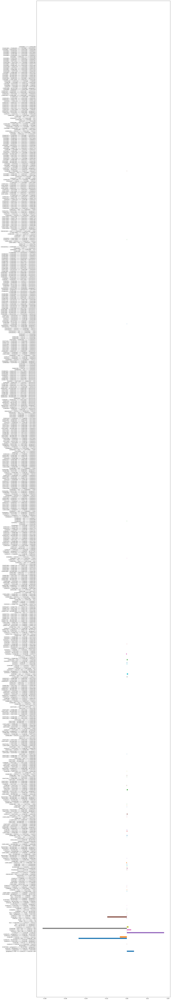

In [126]:
plt.figure(figsize=(20,150))
all_rxns_sens = pd.read_csv('./sens_all_rxns_pureEthane_isothermal.csv')
for index, row in all_rxns_sens.iterrows():
    if index == 653:
        for index,column in zip(list(range(0,669)),row):
            if index==0:
                continue
            else:
                plt.barh(str(gas.reactions()[index-1]), float(column))
            if float(column) < -0.05:
                print(gas.reactions()[index-1])
            if float(column) > 0.01:
                print(gas.reactions()[index-1])



In [114]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm


#mole_frac_dict = {'C2H6(36)': 1, 'He': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases
mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='on') #adiabatic reactor
#r = ct.IdealGasConstPressureReactor(contents=gas, energy='on')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

# sim.rtol_sensitivity = 1.0e-6
# sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])

# dt_max = 1.e-5 
# t_end = 100000000000000 * dt_max
t_end = 10000

count=0
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    count+=1
# print(count)
#states.to_pandas().to_csv('./sensitivities_Ethane.csv')

#after analyzing all the sensitivities, it is clear that reaction 25 

Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [115]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('C2H4(38)')], states.t))
df.to_csv('./C2H4_mole_fractions_adiabatic.csv')

Text(0.5, 1.0, 'mole fraction of ethene over time in an adiabatic reactor')

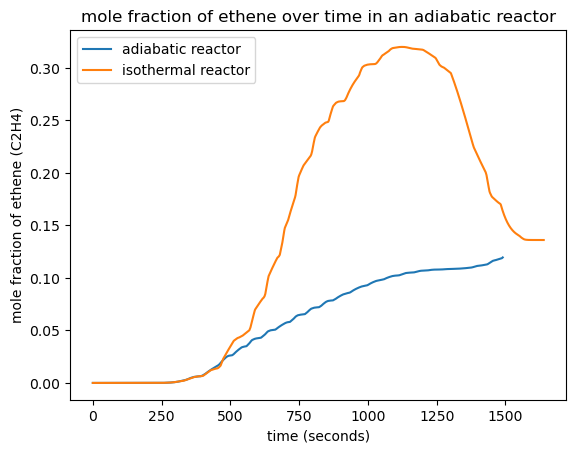

In [117]:
adiab = pd.read_csv('./C2H4_mole_fractions_adiabatic.csv')
iso = pd.read_csv('./C2H4_mole_fractions_isothermal.csv')

adiab_mf, adiab_t = adiab.iloc[:,0], adiab.iloc[:,1] 
iso_mf, iso_t = iso.iloc[:,0], iso.iloc[:,1] 


plt.plot(adiab_mf, adiab_t,label='adiabatic reactor')
plt.plot(iso_mf, iso_t, label='isothermal reactor')
plt.legend()
# plt.xlim(0,100)
plt.xlabel('time (seconds)')
plt.ylabel('mole fraction of ethene (C2H4)') 
plt.title('mole fraction of ethene over time in an adiabatic reactor') 

In [148]:
#conditions 
T = 1000 #K
P = 1*ct.one_atm


#mole_frac_dict = {'C2H6(36)': 1, 'He': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases
mole_frac_dict = {'C2H6(36)': 1} #1 ppmv in ethane = 1 micromole in 1 mole of ethane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='on') #adiabatic reactor
#r = ct.IdealGasConstPressureReactor(contents=gas, energy='on')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

# sim.rtol_sensitivity = 1.0e-6
# sim.atol_sensitivity = 1.0e-6

columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
sens_all_reactions = [columns]

for i in range(len(gas.reactions())):
    r.add_sensitivity_reaction(i)
    
states = ct.SolutionArray(gas, extra=['t'])

# dt_max = 1.e-5 
# t_end = 100000000000000 * dt_max
t_end = 10000


while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    sensitivities = []
    for index, rxn in enumerate(gas.reactions()):
        sens = sim.sensitivity('C2H6(36)', index)
        sensitivities.append(sens)
    sens_all_reactions.append(sensitivities)



Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0


KeyboardInterrupt: 

In [119]:
df_sens = pd.DataFrame(sens_all_reactions)
df_sens.to_csv('./sens_all_rxns_pureEthane_adiabatic.csv')

/work/westgroup/nora/miniconda/envs/rmg_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,24

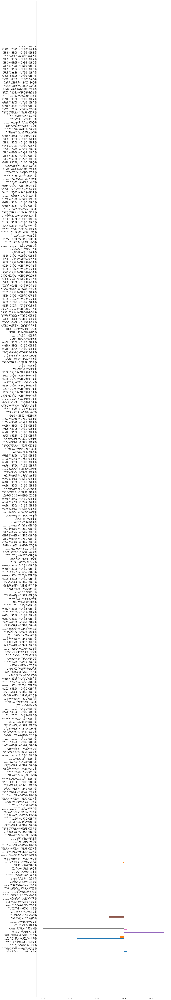

In [120]:
plt.figure(figsize=(20,150))
all_rxns_sens = pd.read_csv('./sens_all_rxns_pureEthane_adiabatic.csv')
for index, row in all_rxns_sens.iterrows():
    if index == 653:
        for index,column in zip(list(range(0,669)),row):
            if index==0:
                continue
            else:
                plt.barh(str(gas.reactions()[index-1]), float(column))
            if float(column) < -0.05:
                print(gas.reactions()[index-1])
            if float(column) > 0.01:
                print(gas.reactions()[index-1])



# Question 3.a

**As in Problem 1, consider what happens at short times if a small amount of H 
atom is introduced into pure propane. In this case, there are two competing 
reactions, what are they? How is the half-life of the H atom related to the k’s 
of these two reactions? How is the product distribution related to these two 
k’s?**

I am assuming we are to use an isobaric, isothermal reactor. The two competing reactions are:

* H(2) + propane(1) <=> H2(6) + iC3H7(93)
* H(2) + propane(1) <=> H2(6) + NC3H7(92)

When the k's of these two reactions are kept as their original value, the half life for the H atoms is 1.52e-08 seconds. Doubling the k's of these two reactions leads to a new half life of approximately 7.73-09, therefore increasing the k's of these reactions decreases the half life of the H atom. 


Below is the product distrubution at ~1.5e-08 seconds (half life of H atoms before doubling k's). As you can see, most of the products are increasing as the k's of these two reactions increases.


In [239]:
#conditions, pure propane, isothermal reactor 
T = 1000 #K
P = ct.one_atm


mole_frac_dict = {'H(2)': 1/1000000, 'propane(1)': 1} #1 ppmv of H atoms in propane = 1 micromole in 1 mole of propane assuming ideal gases

gas = ct.Solution('propanepyrolysis.cti')
gas.TPX = T, P, mole_frac_dict

r = ct.IdealGasConstPressureReactor(contents=gas, energy='off') #isobaric reactor, energy off makes it isothermal
#r = ct.ConstPressureReactor(contents=gas, energy='off')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

# sim.rtol_sensitivity = 1.0e-6
# sim.atol_sensitivity = 1.0e-6


states = ct.SolutionArray(gas, extra=['t'])



#dt_max = 1.e-5 
#t_end = 100000000000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]
# sens_all_reactions = [columns]

# for i in range(len(gas.reactions())):
#     r.add_sensitivity_reaction(i)
    
t_end = 10000
while sim.time < t_end:
    sim.step()
    states.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    # sensitivities=[]
    # rop_df.append(r.kinetics.net_rates_of_progress)
    # for index, rxn in enumerate(gas.reactions()):
    #     sens = sim.sensitivity('H(2)', index)
    #     sensitivities.append(sens)
    # sens_all_reactions.append(sensitivities)


Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


In [193]:
# print(states.X[58,gas.species_index('H(2)')], states.t[58])
# print(states_D.X[71,gas_D.species_index('H(2)')], states_D.t[71])
gas_conc_at_same_time = []
gas_D_conc_at_same_time = []
for species in gas.species():
    gas_conc_at_same_time.append(states.X[58,gas.species_index(species.name)])
    gas_D_conc_at_same_time.append(states_D.X[71,gas_D.species_index(species.name)])
                                   
pd.DataFrame(data=zip(gas.species(), gas_conc_at_same_time, gas_D_conc_at_same_time), columns=['species', 'original concentration',"concentrations after doubling the two k's"])

    

,species,original concentration,concentrations after doubling the two k's
0,<Species He>,6.897819e-32,-1.390065e-31
1,<Species Ne>,0.000000e+00,0.000000e+00
2,<Species propane(1)>,9.999985e-01,9.999982e-01
3,<Species H(2)>,4.979463e-07,2.525580e-07
4,<Species H2(6)>,5.023264e-07,7.478837e-07
5,<Species CH3(14)>,2.131181e-09,3.279606e-09
6,<Species CH4(15)>,1.008713e-12,1.567811e-12
7,<Species C2H6(36)>,2.460489e-14,2.389012e-14
8,<Species C2H5(37)>,2.444535e-10,2.413201e-10
9,<Species C2H4(38)>,1.887702e-09,3.039823e-09


In [150]:
df = pd.DataFrame(zip(states.X[:,gas.species_index('H(2)')], states.t))
df.to_csv('./H_mole_fractions_propane.csv')

In [129]:
df_sens = pd.DataFrame(sens_all_reactions)
df_sens.to_csv('./sens_all_rxns_purePropane.csv')

/work/westgroup/nora/miniconda/envs/rmg_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,24

propane(1) (+M) <=> C2H5(37) + CH3(14) (+M)
CH3(14) + propane(1) <=> CH4(15) + IC3H7(93)
CH3(14) + propane(1) <=> CH4(15) + NC3H7(92)
NC3H7(92) <=> IC3H7(93)
C2H4(38) + CH3(14) <=> NC3H7(92)
2 CH3(14) (+M) <=> C2H6(36) (+M)
C2H4(38) + H(2) (+M) <=> C2H5(37) (+M)
CH4(15) + H(2) <=> CH3(14) + H2(6)
H(2) + propane(1) <=> H2(6) + IC3H7(93)
H(2) + propane(1) <=> H2(6) + NC3H7(92)
C3H6(95) + H(2) <=> NC3H7(92)
C3H6(95) + H(2) <=> IC3H7(93)
C3H6(95) + H(2) <=> IC3H7(93)
2 IC3H7(93) <=> C3H6(95) + propane(1)
C3H5-A(94) + propane(1) <=> C3H6(95) + IC3H7(93)
C3H6(95) + CH3(14) <=> C3H5-A(94) + CH4(15)
C3H5-A(94) + IC3H7(93) <=> 2 C3H6(95)


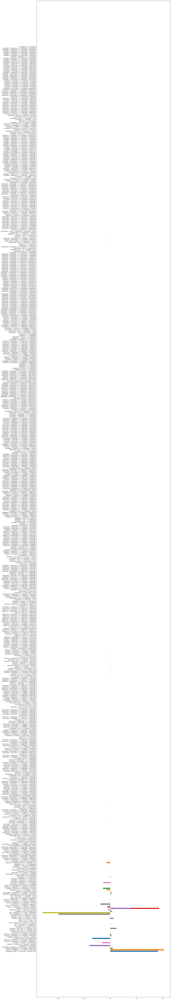

In [130]:
plt.figure(figsize=(20,150))
all_rxns_sens = pd.read_csv('./sens_all_rxns_purePropane.csv')
for index, row in all_rxns_sens.iterrows():
    if index == 653:
        for index,column in zip(list(range(0,669)),row):
            if index==0:
                continue
            else:
                plt.barh(str(gas.reactions()[index-1]), float(column))
            if float(column) < -0.05:
                print(gas.reactions()[index-1])
            if float(column) > 0.01:
                print(gas.reactions()[index-1])

In [132]:
df_rop = pd.DataFrame(rop_df)
df_rop.to_csv('./rop_propane.csv')

Text(0.5, 1.0, 'Net production rates of all reactions over time')

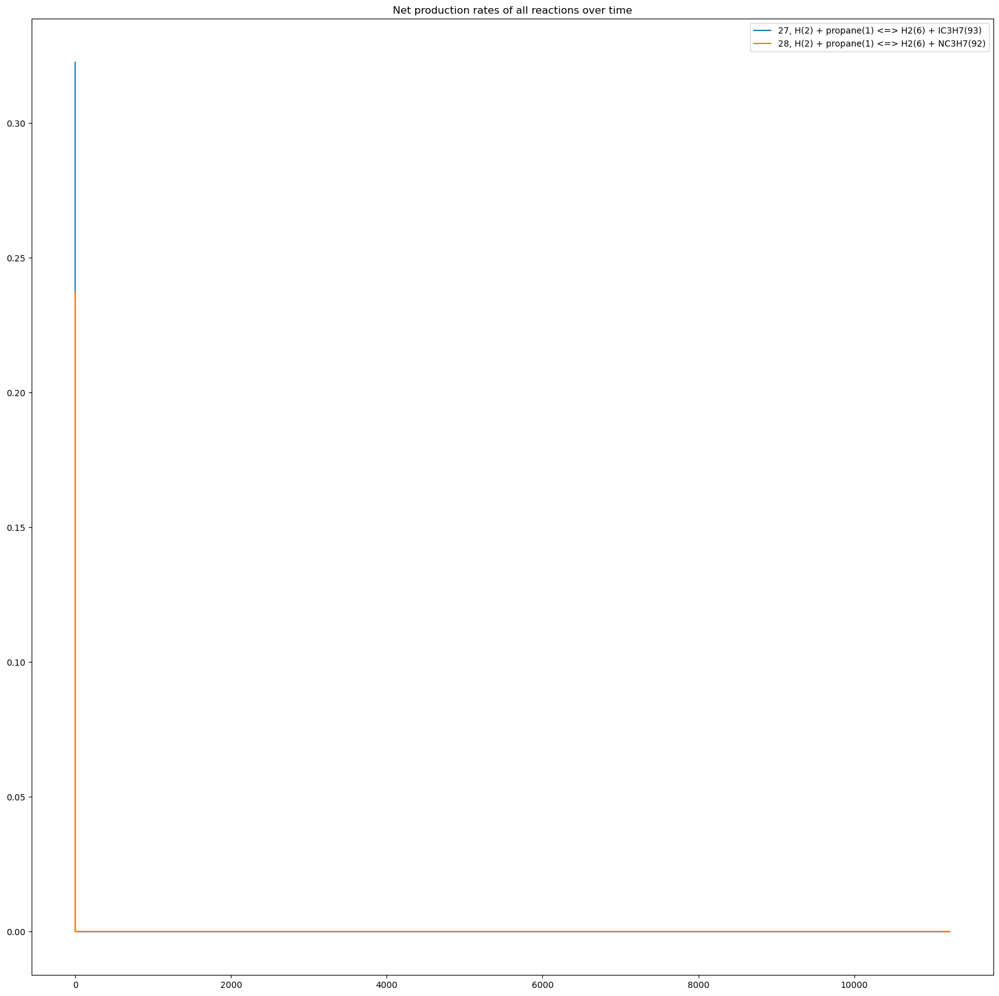

In [141]:
plt.figure(figsize=(20,20))
for column in df_rop: 
    rop = df_rop[column].to_list()
    #plt.plot(states.t, [float(x) for x in rop[1:]], label = rop[0])
    # if float(rop[1])<-0.002:
    #     plt.plot(states.t, [float(x) for x in rop[1:]], label = rop[0])
    if float(rop[1])>0.2:
        plt.plot(states.t, [float(x) for x in rop[1:]], label = rop[0])

plt.legend()
# plt.ylim(-0.0025, 0.007)
plt.title('Net production rates of all reactions over time')
    

In [183]:
#conditions, pure propane, isothermal reactor 
T = 1000 #K
P = ct.one_atm


mole_frac_dict = {'H(2)': 1/1000000, 'propane(1)': 1} #1 ppmv of H atoms in propane = 1 micromole in 1 mole of propane assuming ideal gases

gas_D = ct.Solution('propanepyrolysis.cti')
gas_D.TPX = T, P, mole_frac_dict
gas_D.set_multiplier(2, i_reaction=27) #double the k's of these reactions 
gas_D.set_multiplier(2, i_reaction=28)
r = ct.IdealGasConstPressureReactor(contents=gas_D, energy='off') #isobaric reactor, energy off makes it isothermal
#r = ct.ConstPressureReactor(contents=gas, energy='off')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

# sim.rtol_sensitivity = 1.0e-6
# sim.atol_sensitivity = 1.0e-6


states_D = ct.SolutionArray(gas_D, extra=['t'])



#dt_max = 1.e-5 
#t_end = 100000000000000 * dt_max


# columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas_D.reactions())] 
# rop_df = [columns]
# # sens_all_reactions = [columns]
# sens_all_reactions = [columns]

# for i in range(len(gas_D.reactions())):
#     r.add_sensitivity_reaction(i)
    
t_end = 10000
while sim.time < t_end:
    sim.step()
    states_D.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    # sensitivities=[]
    # rop_df.append(r.kinetics.net_rates_of_progress)
    # for index, rxn in enumerate(gas_D.reactions()):
    #     sens = sim.sensitivity('H(2)', index)
    #     sensitivities.append(sens)
    # sens_all_reactions.append(sensitivities)

df = pd.DataFrame(zip(states_D.X[:,gas_D.species_index('H(2)')], states.t))
df.to_csv('./H_mole_fractions_propane_doubled.csv')

Initializing reactor network.
Reactor 0: 52 variables.
              0 sensitivity params.
Number of equations: 52
Maximum time step:                0


    
# Question 3.b
    
**Simulate the pyrolysis of pure propane at 850 K and 1000 K, for P=1 atm, in 
an isothermal plug flow reactor with an inlet flow velocity of 1 cm/second. 
Note that a much longer reactor is needed at the lower temperature.** 

In [224]:
#conditions, pure propane, isothermal reactor 
T = 850 #K
P = ct.one_atm

length = 1  # *approximate* PFR length [m]
u_0 = 0.01  # inflow velocity [m/s], this equal to 1 cm/s
area = 1.e-4  # cross-sectional area [m**2]

n_steps = 500



mole_frac_dict = {'propane(1)': 1} #1 ppmv of H atoms in propane = 1 micromole in 1 mole of propane assuming ideal gases

gas_850 = ct.Solution('propanepyrolysis.cti')
gas_850.TPX = T, P, mole_frac_dict

mass_flow_rate = u_0 * gas_850.density * area
dz = length / n_steps 
r_vol = area * dz


r = ct.IdealGasConstPressureReactor(contents=gas_850, energy='off') #isobaric reactor, energy off makes it isothermal
#r = ct.ConstPressureReactor(contents=gas, energy='off')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

#approximate a time step to achieve a similar resolution as in the next method
t_total = length / u_0
dt = t_total / n_steps

# define time, space, and other information vectors
t1 = (np.arange(n_steps) + 1) * dt
z1 = np.zeros_like(t1)
u1 = np.zeros_like(t1)


states_850 = ct.SolutionArray(gas_850, extra=['t'])



#dt_max = 1.e-5 
#t_end = 100000000000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas_850.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]
sens_all_reactions = [columns]

for i in range(len(gas_850.reactions())):
    r.add_sensitivity_reaction(i)
    
# t_end = 10000
# while sim.time < t_end:

for n1, t_i in enumerate(t1):
    sim.advance(t_i)
    u1[n1] = mass_flow_rate / area / r.thermo.density
    z1[n1] = z1[n1 - 1] + u1[n1] * dt

    states_850.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    # sensitivities=[]
    rop_df.append(r.kinetics.net_rates_of_progress)
    # for index, rxn in enumerate(gas.reactions()):
    #     sens = sim.sensitivity('H(2)', index)
    #     sensitivities.append(sens)
    # sens_all_reactions.append(sensitivities)


Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0


Text(0, 0.5, 'mole fractions')

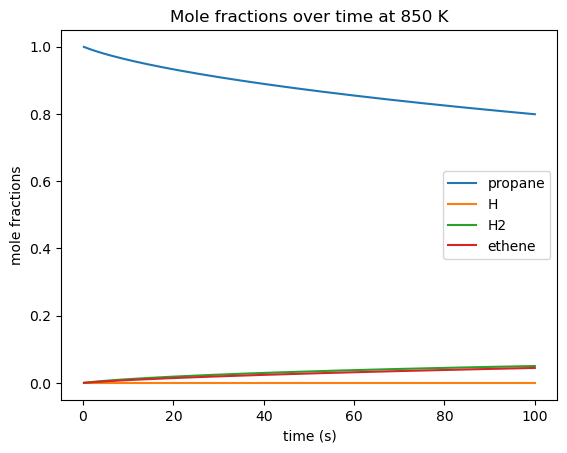

In [225]:
plt.plot(states_850.t, states_850.X[:,gas_850.species_index('propane(1)')], label='propane')
plt.plot(states_850.t, states_850.X[:,gas_850.species_index('H(2)')],label='H')
plt.plot(states_850.t, states_850.X[:,gas_850.species_index('H2(6)')], label='H2')
plt.plot(states_850.t, states_850.X[:,gas_850.species_index('C2H4(38)')], label='ethene')

plt.legend()
plt.title('Mole fractions over time at 850 K')
plt.xlabel('time (s)')
plt.ylabel('mole fractions') 

In [220]:
#conditions, pure propane, isothermal reactor 
T = 1000 #K
P = ct.one_atm

length = 1  # *approximate* PFR length [m]
u_0 = 0.01  # inflow velocity [m/s], this equal to 1 cm/s
area = 1.e-4  # cross-sectional area [m**2]

n_steps = 500



mole_frac_dict = {'propane(1)': 1} #1 ppmv of H atoms in propane = 1 micromole in 1 mole of propane assuming ideal gases

gas_1000 = ct.Solution('propanepyrolysis.cti')
gas_1000.TPX = T, P, mole_frac_dict

mass_flow_rate = u_0 * gas_1000.density * area
dz = length / n_steps 
r_vol = area * dz


r = ct.IdealGasConstPressureReactor(contents=gas_1000, energy='off') #isobaric reactor, energy off makes it isothermal
#r = ct.ConstPressureReactor(contents=gas, energy='off')
sim = ct.ReactorNet([r]) 
sim.verbose = True

sim.atol = 1e-22
sim.rtol = 1e-7

#approximate a time step to achieve a similar resolution as in the next method
t_total = length / u_0
dt = t_total / n_steps

# define time, space, and other information vectors
t1 = (np.arange(n_steps) + 1) * dt
z1 = np.zeros_like(t1)
u1 = np.zeros_like(t1)


states_1000 = ct.SolutionArray(gas_1000, extra=['t'])



#dt_max = 1.e-5 
#t_end = 100000000000000 * dt_max


columns = [f'{index}, {rxn}' for index, rxn in enumerate(gas_1000.reactions())] 
rop_df = [columns]
# sens_all_reactions = [columns]
sens_all_reactions = [columns]

for i in range(len(gas_1000.reactions())):
    r.add_sensitivity_reaction(i)
    
# t_end = 10000
# while sim.time < t_end:

for n1, t_i in enumerate(t1):
    sim.advance(t_i)
    u1[n1] = mass_flow_rate / area / r.thermo.density
    z1[n1] = z1[n1 - 1] + u1[n1] * dt

    states_1000.append(r.thermo.state, t=sim.time) # s10=s10, s11=s11, s12=s12, s13=s13, s14=s14, s16=s16, s25=s25, s36=s36, s39=s39, s53=s53, s74=s74, s80=s80, s94=s94, s105=s105, s115=s115, s125=s125, s138=s138, s154=s154, s167=s167, s192=s192, s226=s226, s241=s241, s272=s272, s299=s299, s326=s326, s341=s341, s356=s356, s374=s374, s401=s401, s437=s437, s464=s464, s490=s490, s522=s522, s542=s542, s575=s575, s617=s617, s639=s639)
    # sensitivities=[]
    rop_df.append(r.kinetics.net_rates_of_progress)
    # for index, rxn in enumerate(gas.reactions()):
    #     sens = sim.sensitivity('H(2)', index)
    #     sensitivities.append(sens)
    # sens_all_reactions.append(sensitivities)


Initializing reactor network.
Reactor 0: 52 variables.
              668 sensitivity params.
Number of equations: 52
Maximum time step:                0


Text(0, 0.5, 'mole fractions')

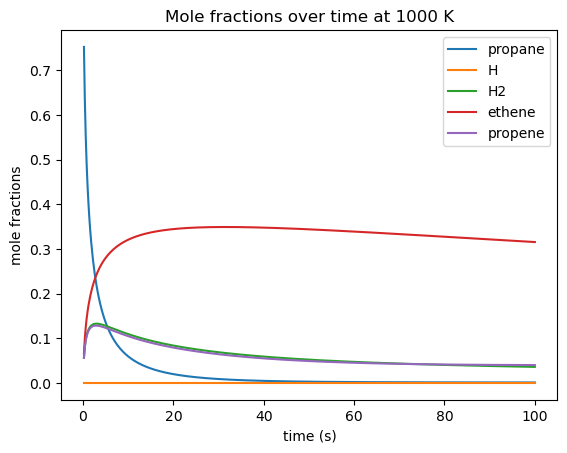

In [238]:
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('propane(1)')], label='propane')
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('H(2)')],label='H')
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('H2(6)')], label='H2')
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('C2H4(38)')], label='ethene')
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('C3H6(95)')], label='propene')


plt.legend()
plt.title('Mole fractions over time at 1000 K')
plt.xlabel('time (s)')
plt.ylabel('mole fractions') 

    
# Question 3.c

**What is the ratio of propene/ethene produced at short times? What is the ratio 
at the point where the propene mole fraction reaches its peak? Are these 
answers different at the two temperatures? If so, why?**

The ratio of propene/ethene at all times for both temperatures shown below. At short times, this value is around 1.38 for the system run at 1000 K and .87 for the system run at 850 K. In the 1000 K system, propene mole fraction peaks to a value of 0.126 at about 2.9 seconds. At 1000 K, the ratio of propene/ethene is 0.5337274835289505 at the 2.9 seconds, while this ratio is 1.374111146474519 at 850 K at 2.9 seconds. These are different because the rate of reactions consuming propene increases drastically between 850 and 1000 K. 

Text(0, 0.5, 'propene/ethene ratio')

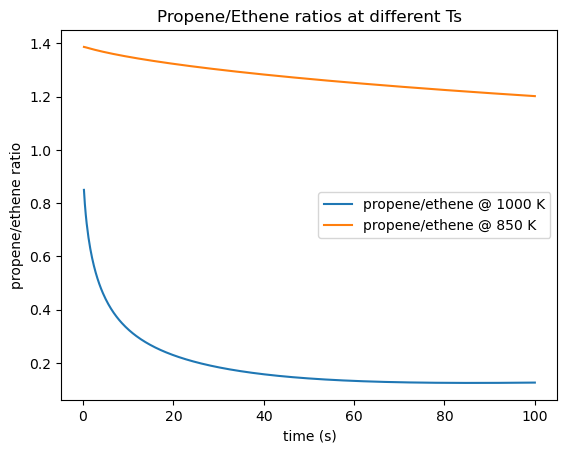

In [228]:
plt.plot(states_1000.t, np.array(states_1000.X[:,gas_1000.species_index('C3H6(95)')])/np.array(states_1000.X[:,gas_1000.species_index('C2H4(38)')]), label='propene/ethene @ 1000 K')
plt.plot(states_850.t, np.array(states_850.X[:,gas_850.species_index('C3H6(95)')])/np.array(states_850.X[:,gas_850.species_index('C2H4(38)')]), label='propene/ethene @ 850 K')

plt.legend()
plt.title('Propene/Ethene ratios at different Ts')
plt.xlabel('time (s)')
plt.ylabel('propene/ethene ratio') 

In [233]:
df_1000= pd.DataFrame(zip(states_1000.t, np.array(states_1000.X[:,gas_1000.species_index('C3H6(95)')])/np.array(states_1000.X[:,gas_1000.species_index('C2H4(38)')])))
df_850 = pd.DataFrame(zip(states_850.t, np.array(states_850.X[:,gas_850.species_index('C3H6(95)')])/np.array(states_850.X[:,gas_850.species_index('C2H4(38)')])))
df_1000.to_csv('./propene_ethene_ratio_1000')
df_850.to_csv('./propene_ethene_ratio_850')

In [235]:
prop_eth_ratio_1000=(0.5395447758416843+0.5279101912162166)/2
prop_eth_ratio_850=(1.3745305692230987+1.3736917237259394)/2

In [236]:
print(prop_eth_ratio_1000,prop_eth_ratio_850)

0.5337274835289505 1.374111146474519


In [230]:
df = pd.DataFrame(zip(states_1000.t, states_1000.X[:,gas_1000.species_index('C3H6(95)')]))
df.to_csv('./propene_molefractions.csv')

Text(0, 0.5, 'propene mole fraction')

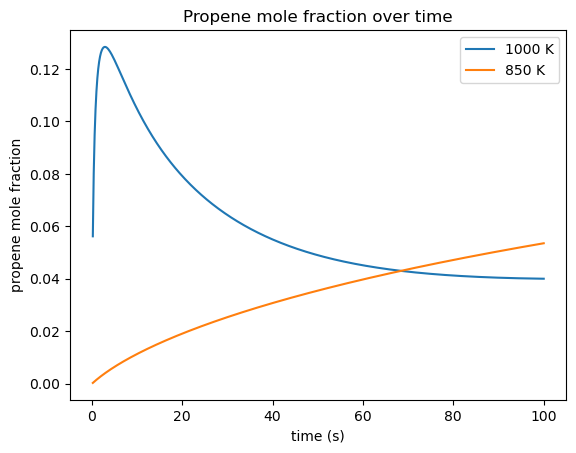

In [231]:
plt.plot(states_1000.t, states_1000.X[:,gas_1000.species_index('C3H6(95)')], label = '1000 K')
plt.plot(states_850.t, states_850.X[:,gas_850.species_index('C3H6(95)')], label = '850 K')
plt.legend()
plt.title('Propene mole fraction over time')
plt.xlabel('time (s)')
plt.ylabel('propene mole fraction') 

# Question 3.d

**Why doesn’t the propene mole fraction keep climbing rapidly like the ethene 
mole fraction does?**

This is because there is reaction from propene to CH3 (i.e. C3H6(95) + H(2) <=> iC3H7(93)) that consume much of the generated propene. 